# NeuroMANCER dynamical systems, system identification, and control tutorial


In [1]:
import pkg
from pkg.signals import signals
import matplotlib.pyplot as plt
%matplotlib inline

# Input signals in neuromancer.psl

For a system identification task, a sequences of input signals must be generated in order to perturb the system across the dyanmic range of the state space. Neuromancer.psl has functions to generate all the standard perturbations used in system identification including:

+ Random walk: walk
+ White noise: noise
+ Random step functions: step
+ Randomly offset periodic functions (sin, cos, square, sawtooth): periodic
+ Sum of sines: sines
+ Auto-regressive moving average: arma
+ Cubic spline interpolation between randomly sampled points: splines

All input signal generator functions have the arguments: 

+ nsim: Length of input signal time series
+ d: Dimension of input signal time series
+ min: Minimum value for input signal time series
+ max: Maximum value for input signal time series

All signals are by default scaled to between min and max, however the unbounded signals white noise, random walk, and ARMA
have a bounded argument which can be set to false if an unbounded signal is desired. 

Below are plots of each signal time series generated with nsim=1000 and d=3.

In [255]:
signals

{'sin': functools.partial(<function periodic at 0x7fd85bf1f9a0>, form='sin'),
 'cos': functools.partial(<function periodic at 0x7fd85bf1f9a0>, form='cos'),
 'square': functools.partial(<function periodic at 0x7fd85bf1f9a0>, form='square'),
 'sawtooth': functools.partial(<function periodic at 0x7fd85bf1f9a0>, form='sawtooth'),
 'walk': <function pkg.signals.walk(nsim, d, min=0.0, max=1.0, sigma=0.05, bound=True)>,
 'noise': <function pkg.signals.noise(nsim, d, min=0.0, max=1.0, sigma=0.05, bound=True)>,
 'step': <function pkg.signals.step(nsim, d, min=0.0, max=1.0, randsteps=30, values=None)>,
 'spline': <function pkg.signals.spline(nsim, d, min=0.0, max=1.0, values=None, n_interpolants=30)>,
 'sines': <function pkg.signals.sines(nsim, d, min=0.0, max=1.0, periods=30, nwaves=20, form='sin')>,
 'arma': <function pkg.signals.arma(nsim, d, min=0.0, max=1.0, q=10, p=10, bound=True)>,
 'prbs': <function pkg.signals.prbs(nsim, d, min=0.0, max=1.0, p=0.9)>}

sin (1000, 3)


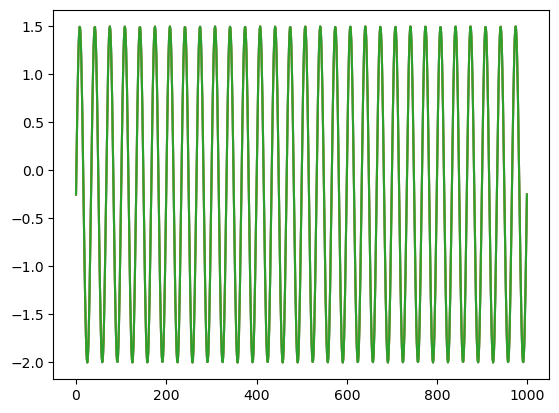

cos (1000, 3)


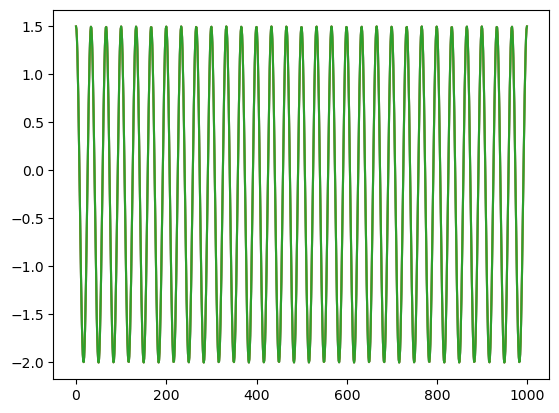

square (1000, 3)


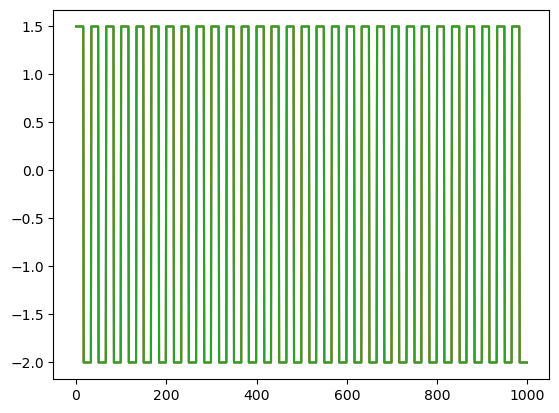

sawtooth (1000, 3)


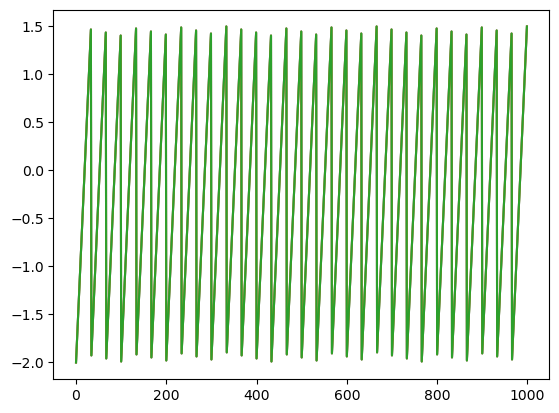

walk (1000, 3)


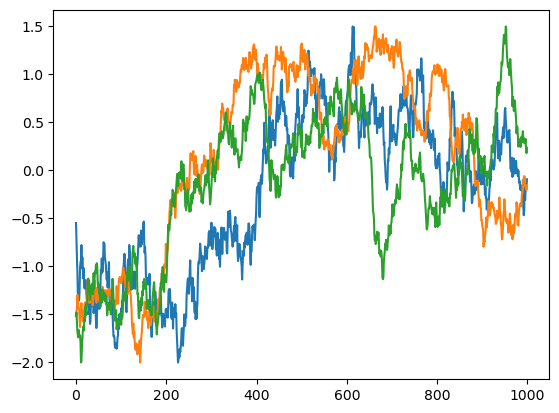

noise (1000, 3)


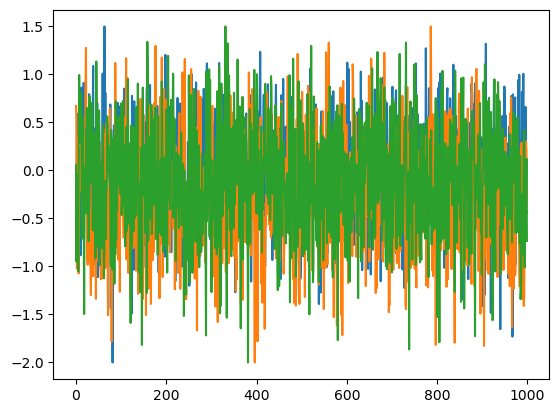

step (1000, 3)


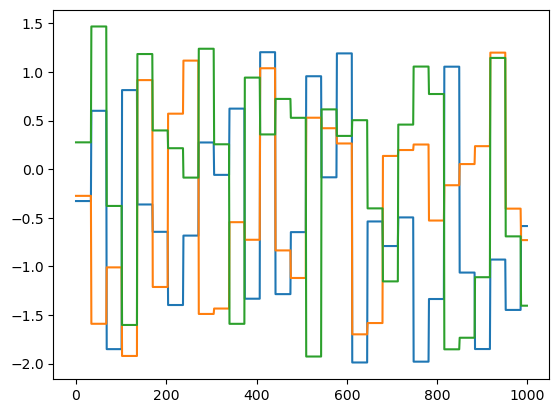

spline (1000, 3)


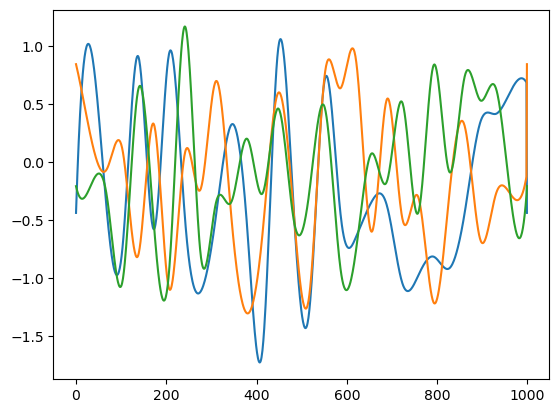

sines (1000, 3)


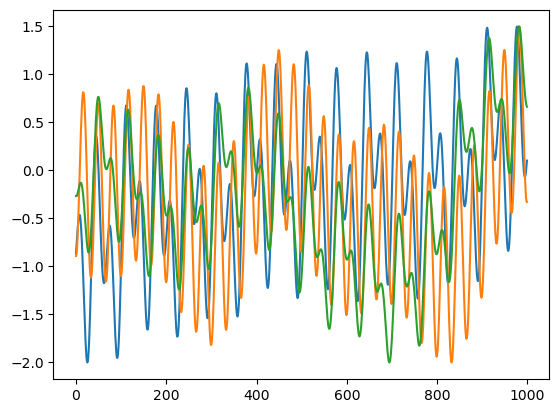

arma (1000, 3)


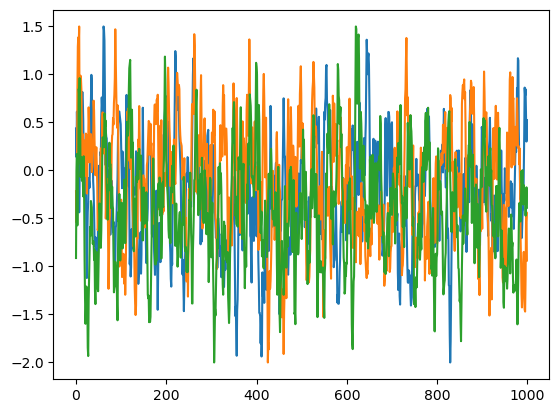

prbs (1000, 3)


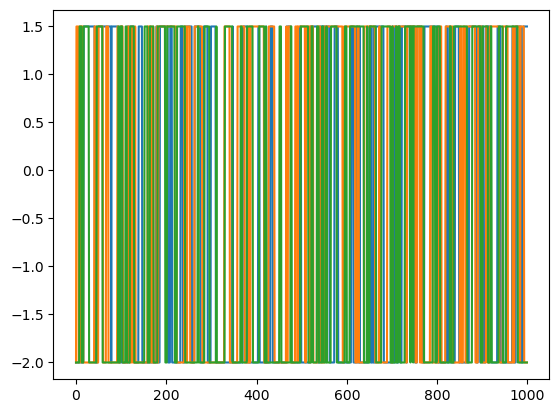

In [256]:
for n, s in signals.items():
    x = s(1000, 3, min=-2., max=1.5)
    print(n, x.shape)
    plt.plot(x)
    plt.show()
    plt.close()

# Systems in NM's Python Systems Library (psl)

The psl subpackage provides systems models for a range of autonomous, nonautonomous, networked, and building envelope systems, as well as an interface for loading and interacting with pre-recorded measurement datasets in common with the systems models. 

In [4]:
pkg.systems

{'Autoignition': pkg.autonomous.Autoignition,
 'Brusselator1D': pkg.autonomous.Brusselator1D,
 'ChuaCircuit': pkg.autonomous.ChuaCircuit,
 'DoublePendulum': pkg.autonomous.DoublePendulum,
 'Duffing': pkg.autonomous.Duffing,
 'Lorenz96': pkg.autonomous.Lorenz96,
 'LorenzSystem': pkg.autonomous.LorenzSystem,
 'LotkaVolterra': pkg.autonomous.LotkaVolterra,
 'Pendulum': pkg.autonomous.Pendulum,
 'RosslerAttractor': pkg.autonomous.RosslerAttractor,
 'ThomasAttractor': pkg.autonomous.ThomasAttractor,
 'UniversalOscillator': pkg.autonomous.UniversalOscillator,
 'VanDerPol': pkg.autonomous.VanDerPol,
 'Actuator': pkg.nonautonomous.Actuator,
 'CSTR': pkg.nonautonomous.CSTR,
 'DuffingControl': pkg.nonautonomous.DuffingControl,
 'HindmarshRose': pkg.nonautonomous.HindmarshRose,
 'InvPendulum': pkg.nonautonomous.InvPendulum,
 'IverSimple': pkg.nonautonomous.IverSimple,
 'LorenzControl': pkg.nonautonomous.LorenzControl,
 'SEIR_population': pkg.nonautonomous.SEIR_population,
 'SwingEquation': pkg.no

Autoignition


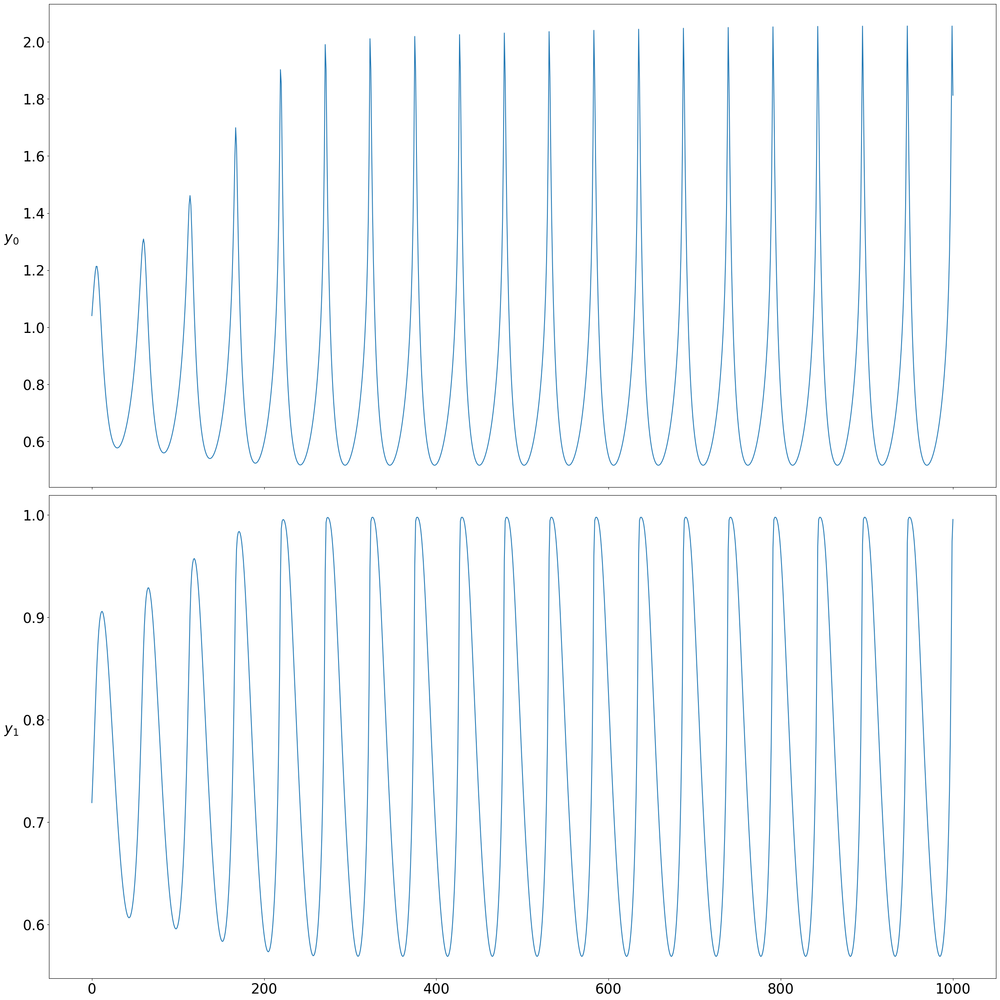

Brusselator1D


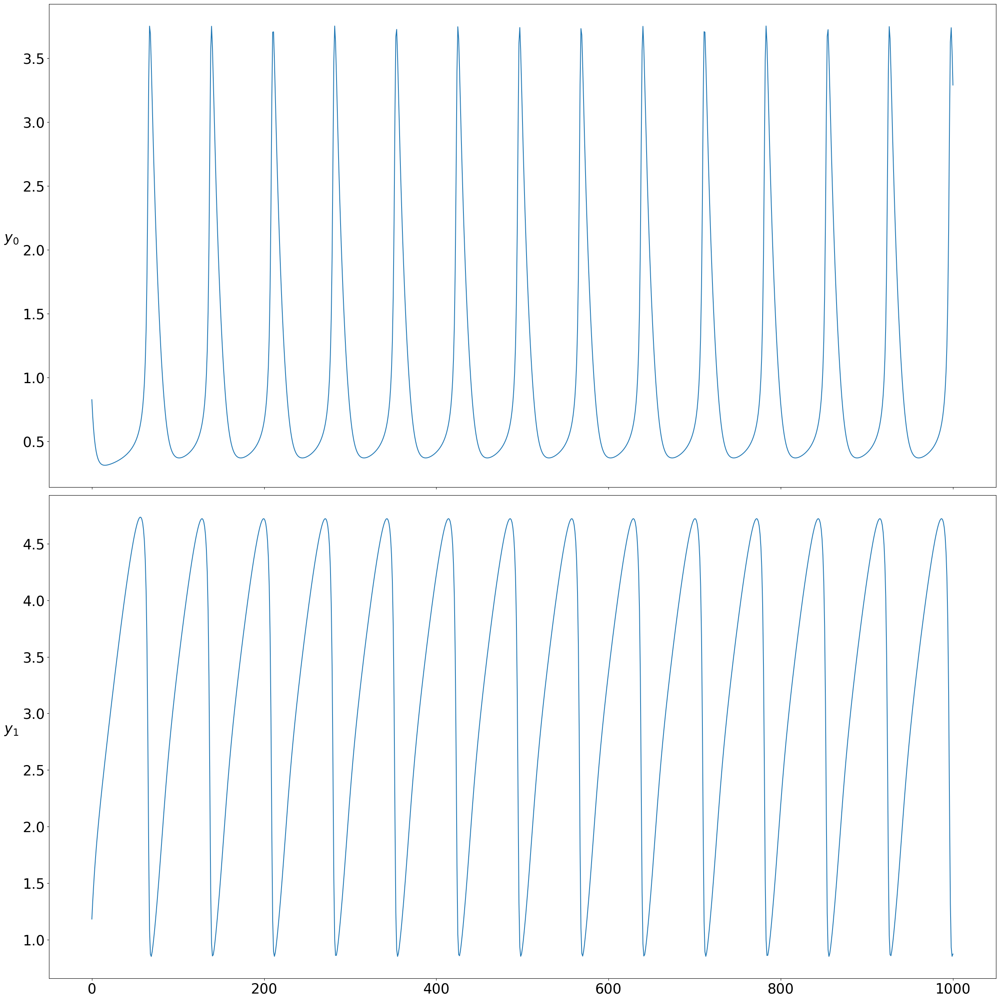

ChuaCircuit


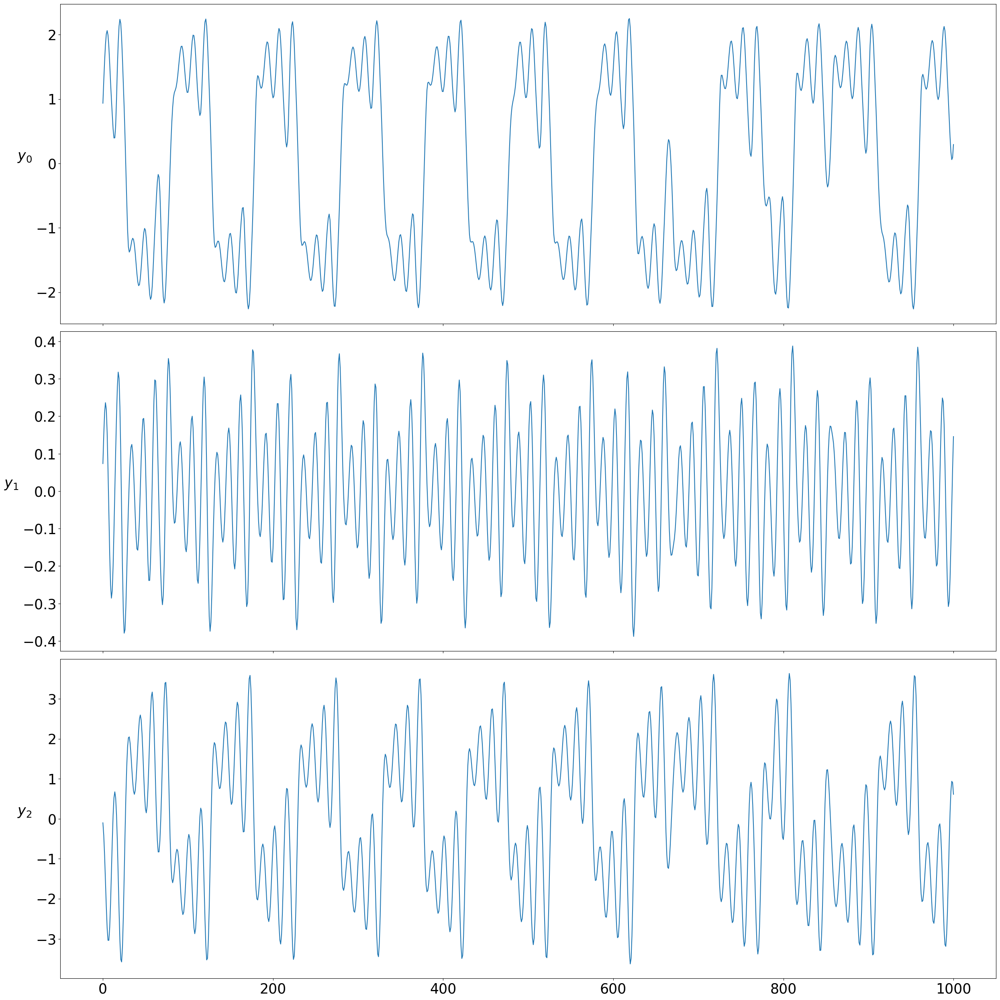

DoublePendulum


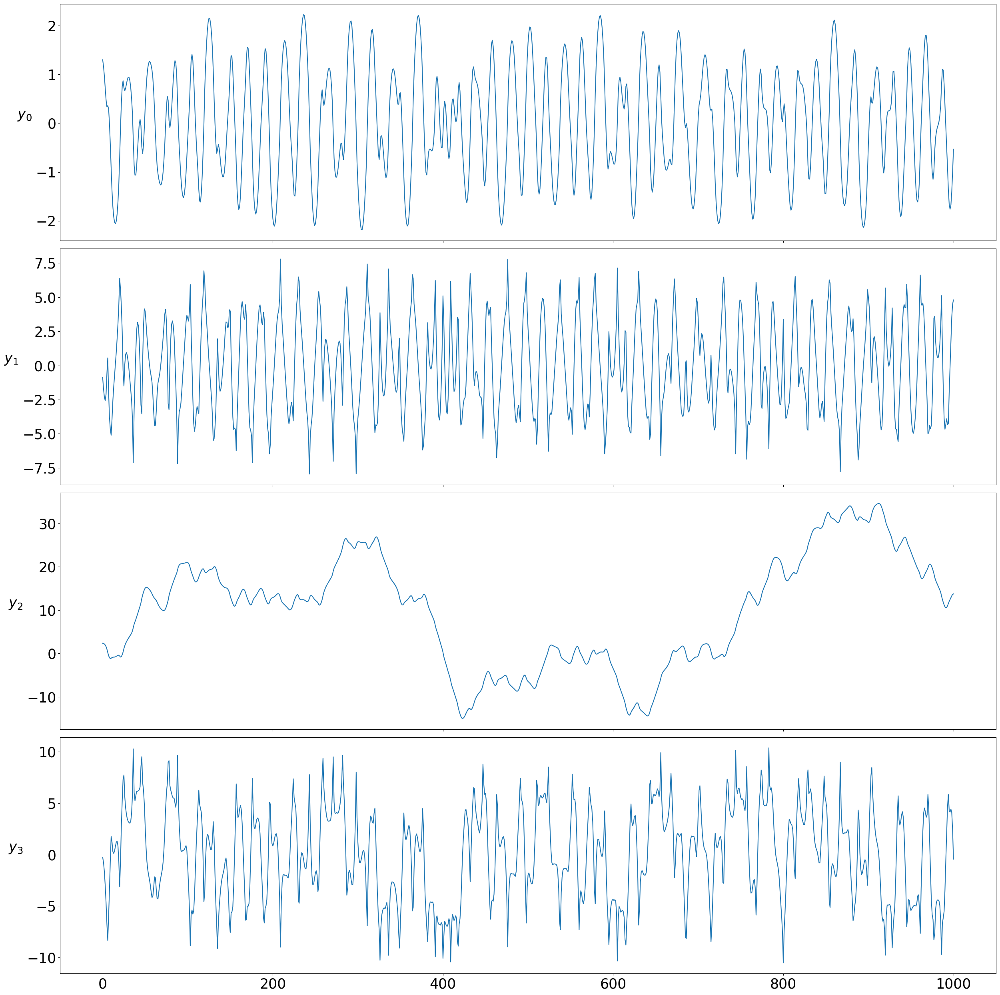

Duffing


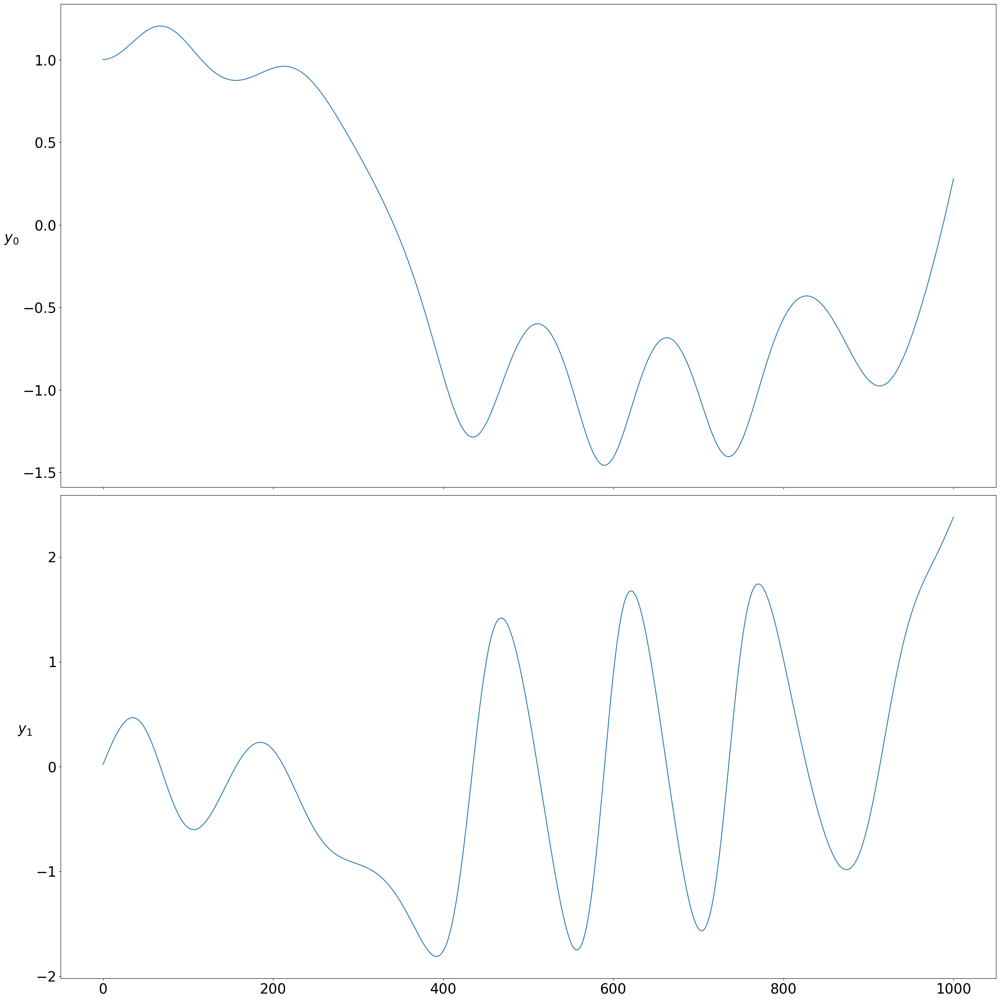

Lorenz96


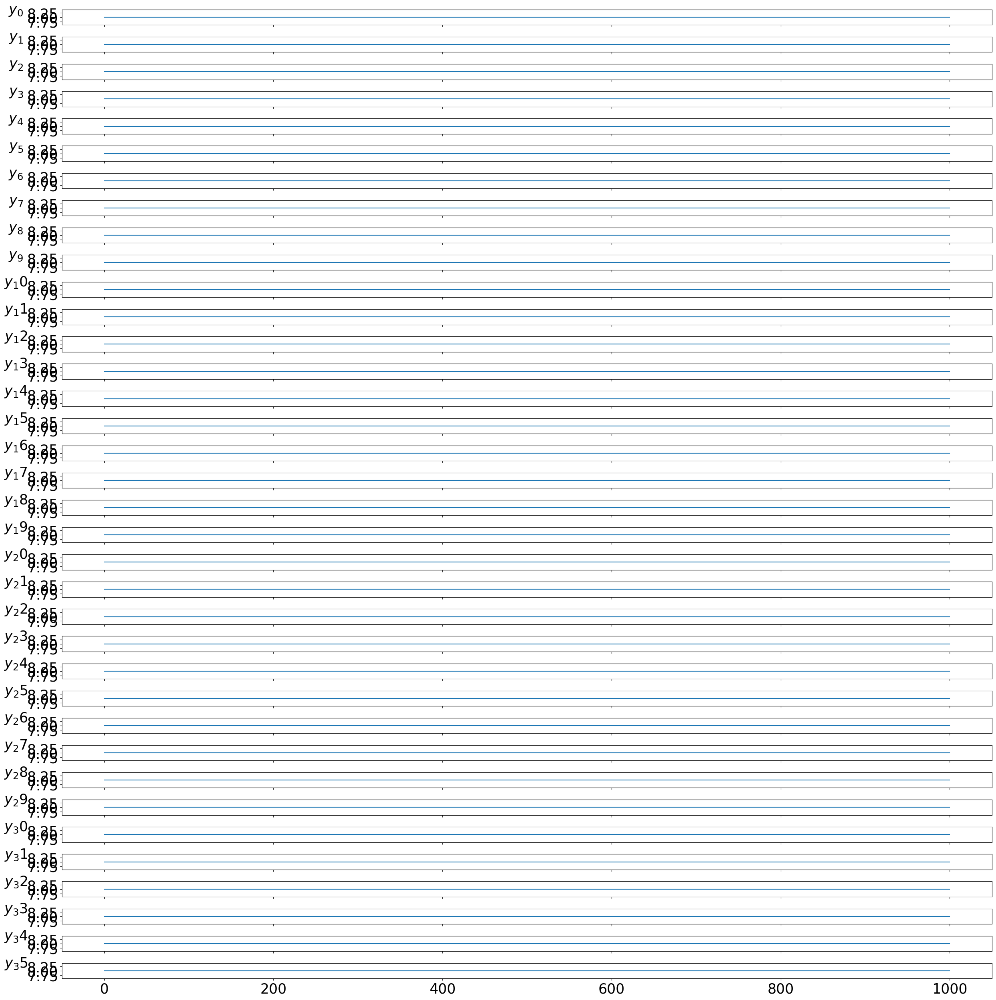

LorenzSystem


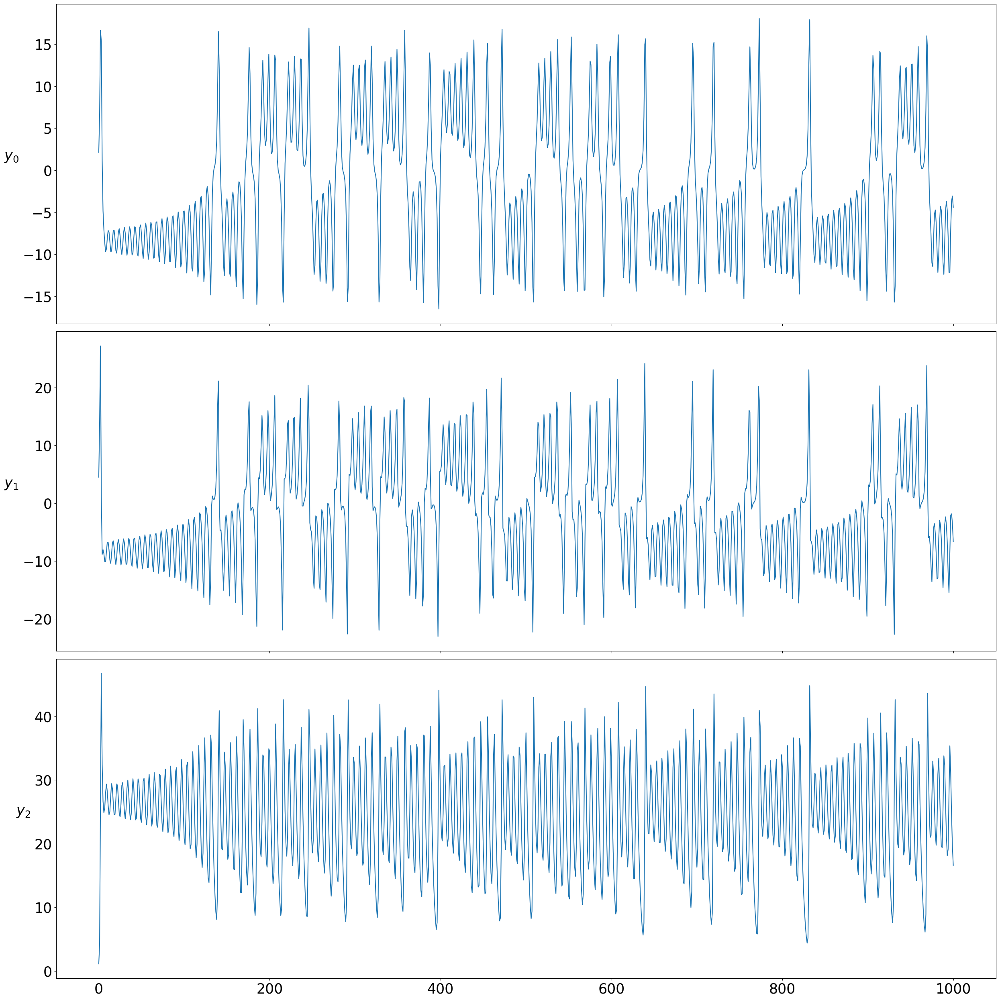

LotkaVolterra


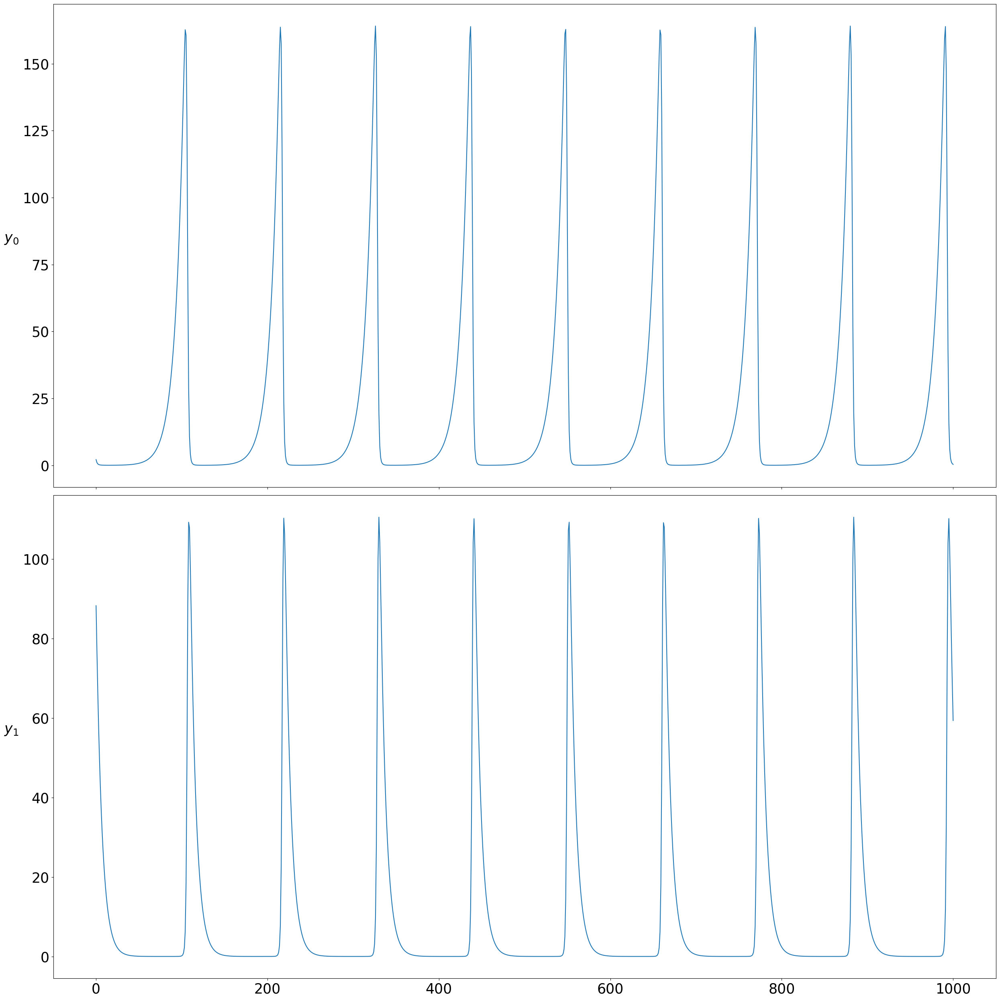

Pendulum


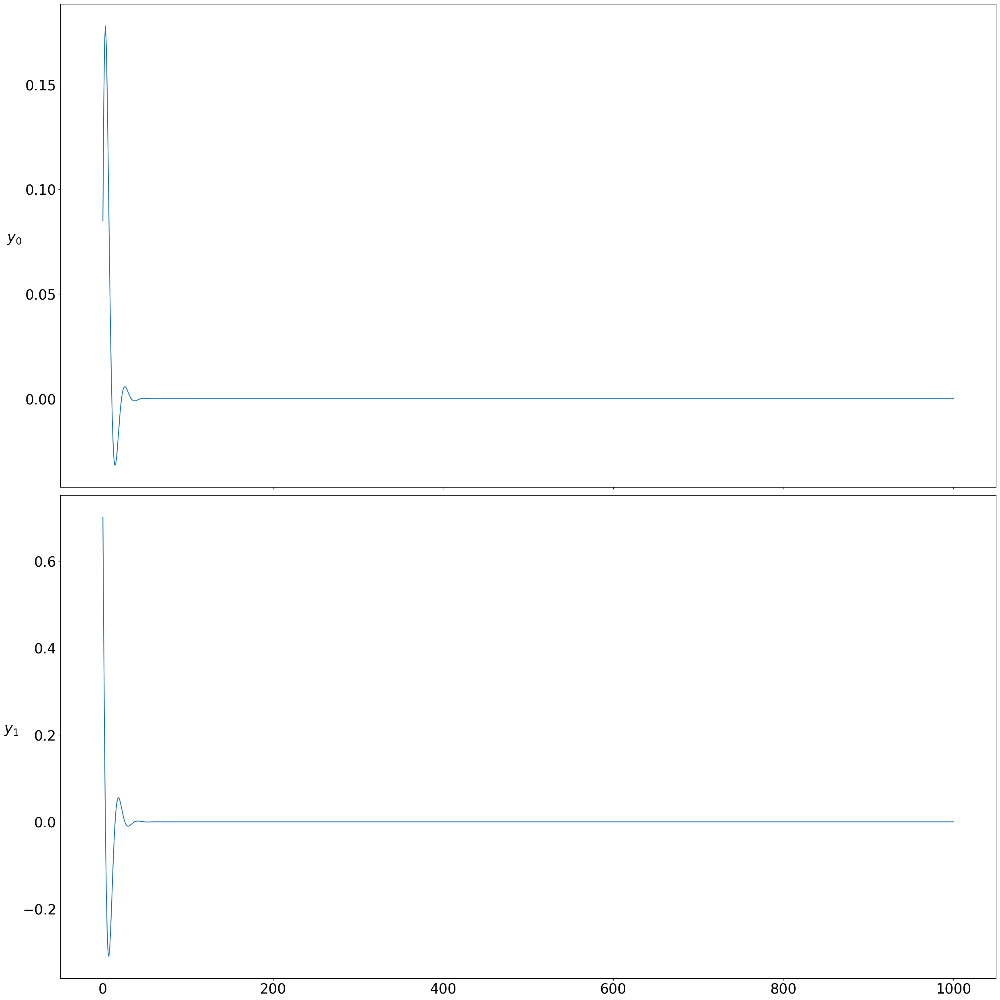

RosslerAttractor


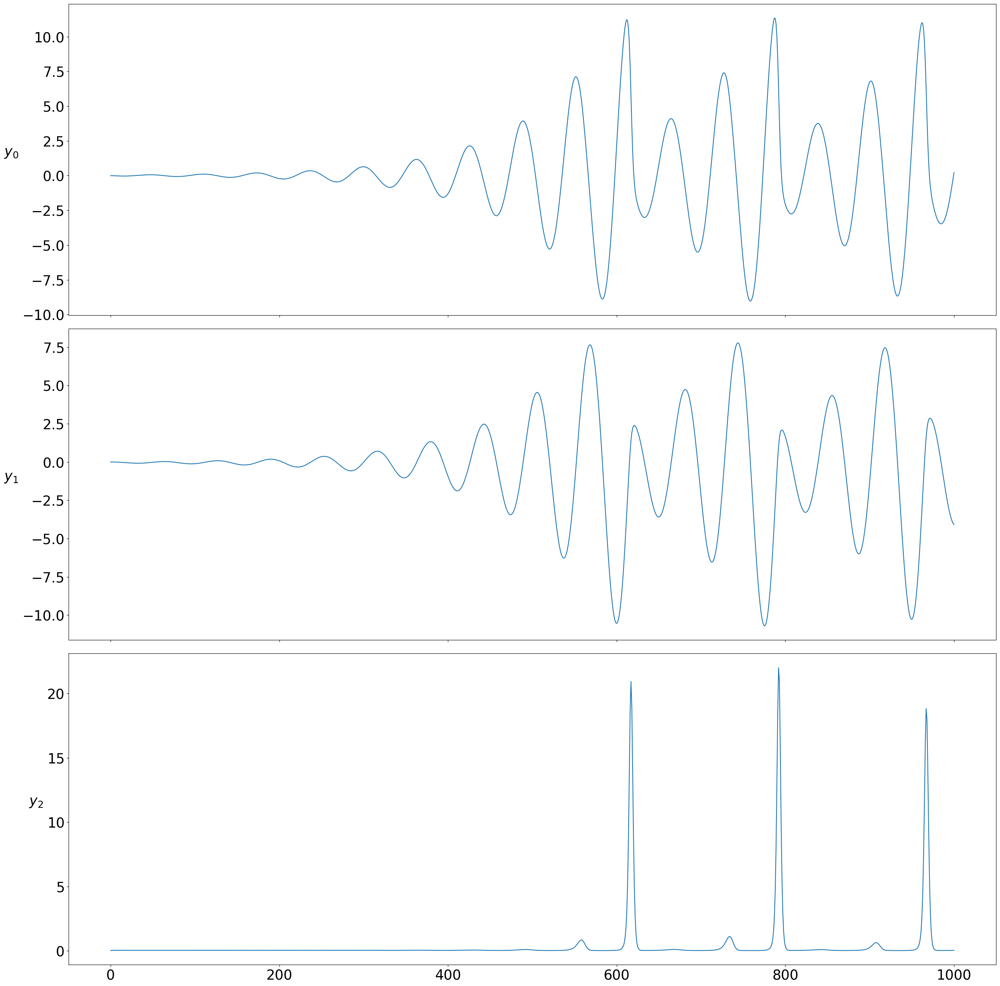

ThomasAttractor


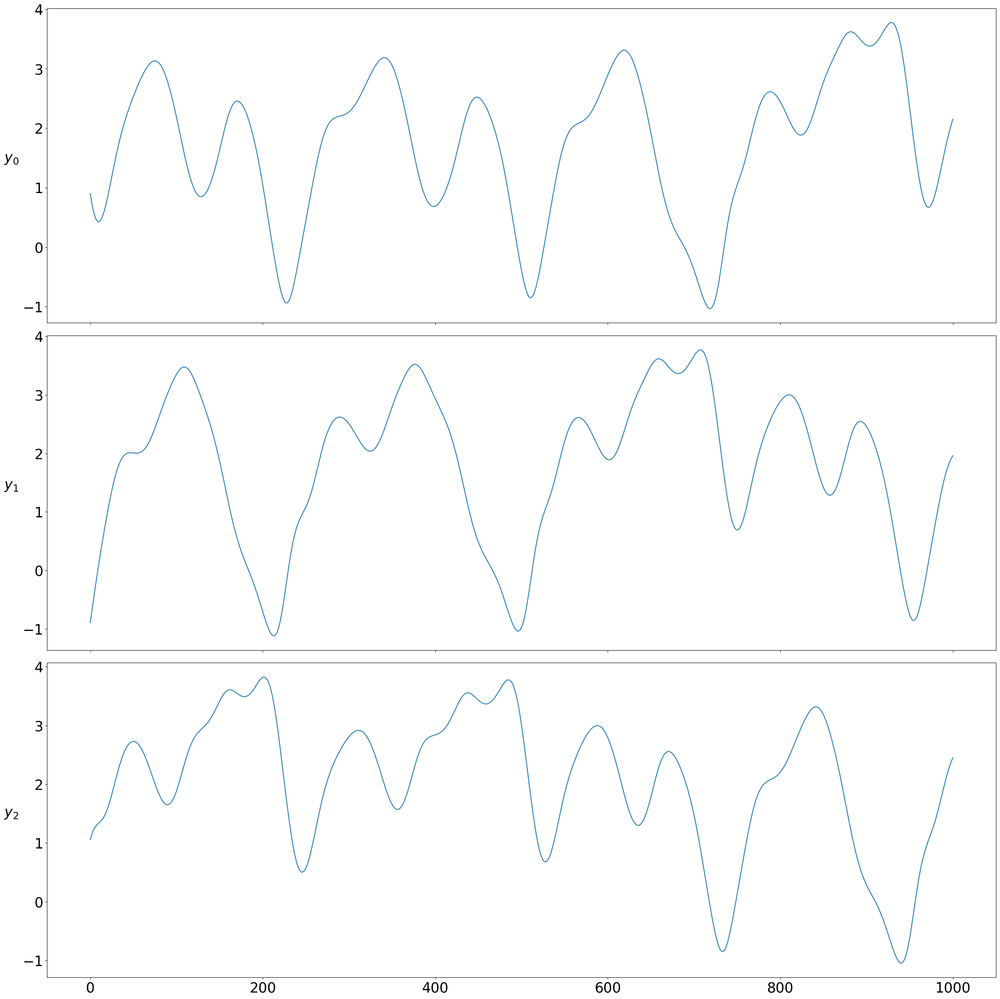

UniversalOscillator


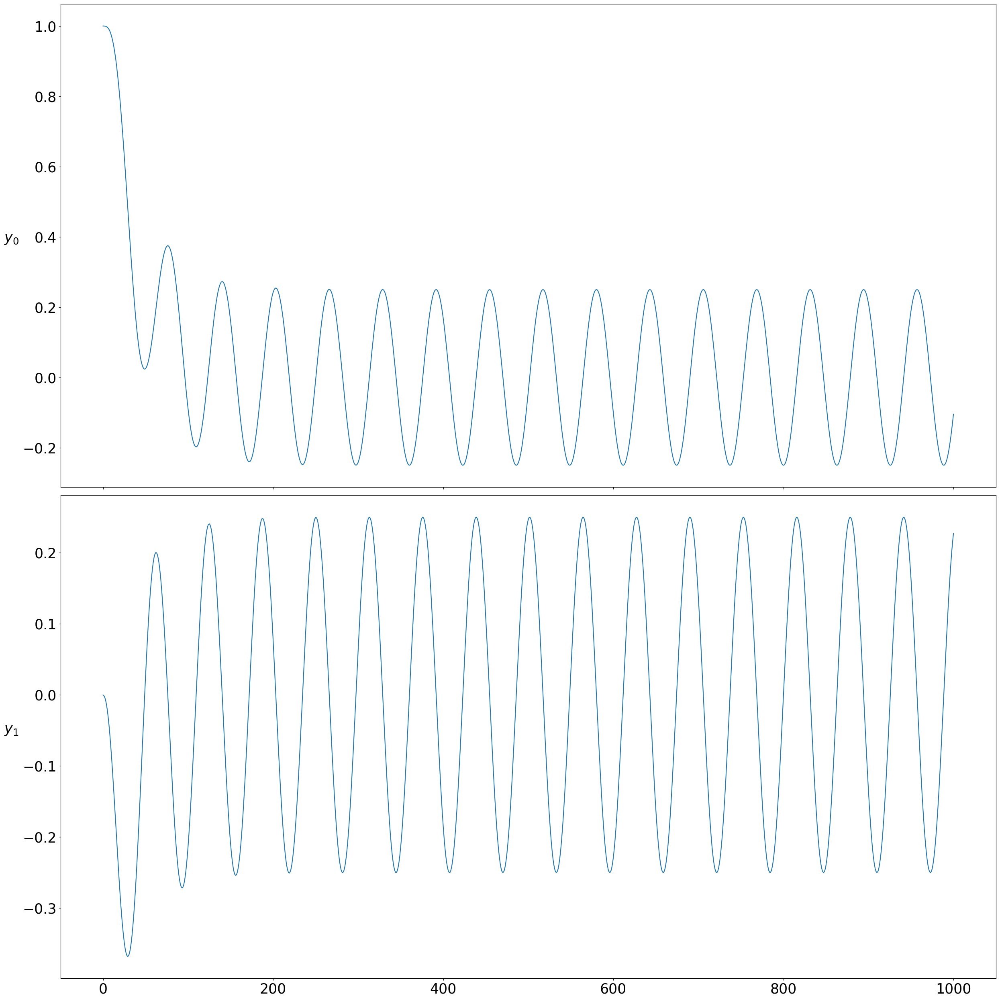

VanDerPol


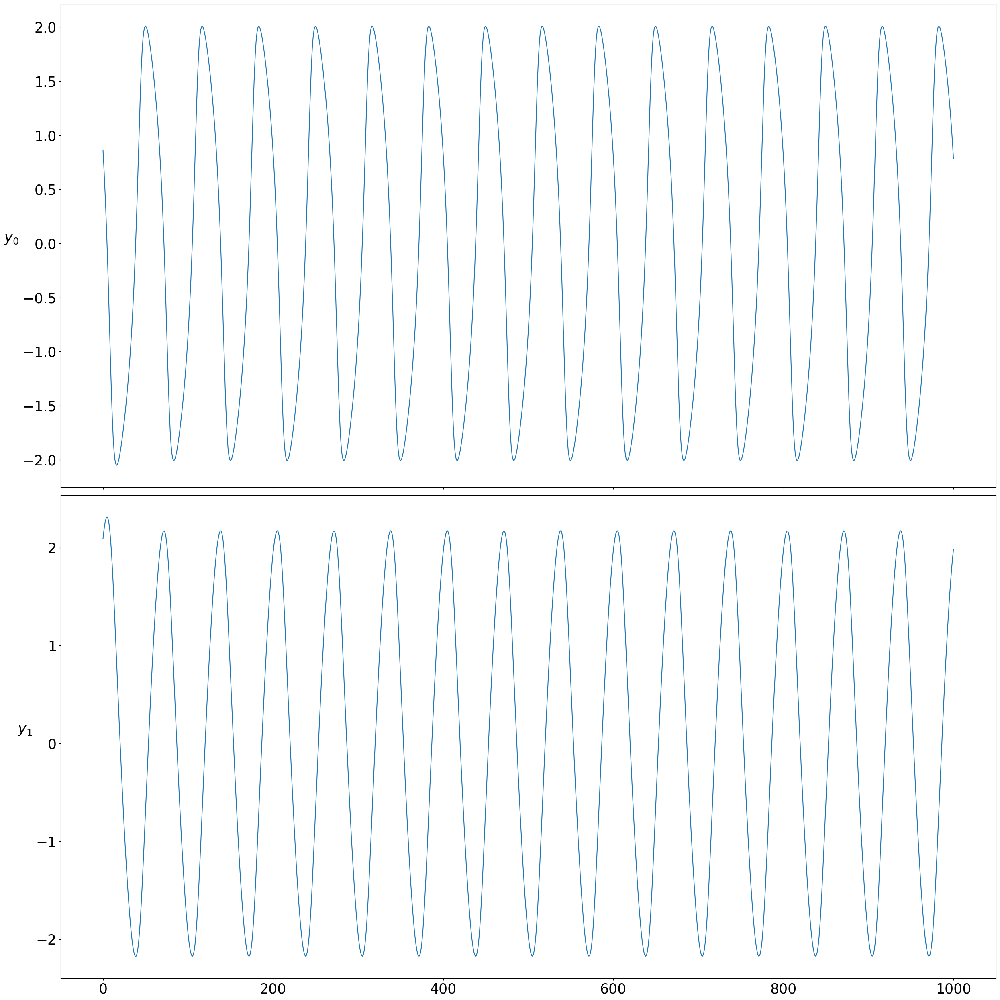

Actuator


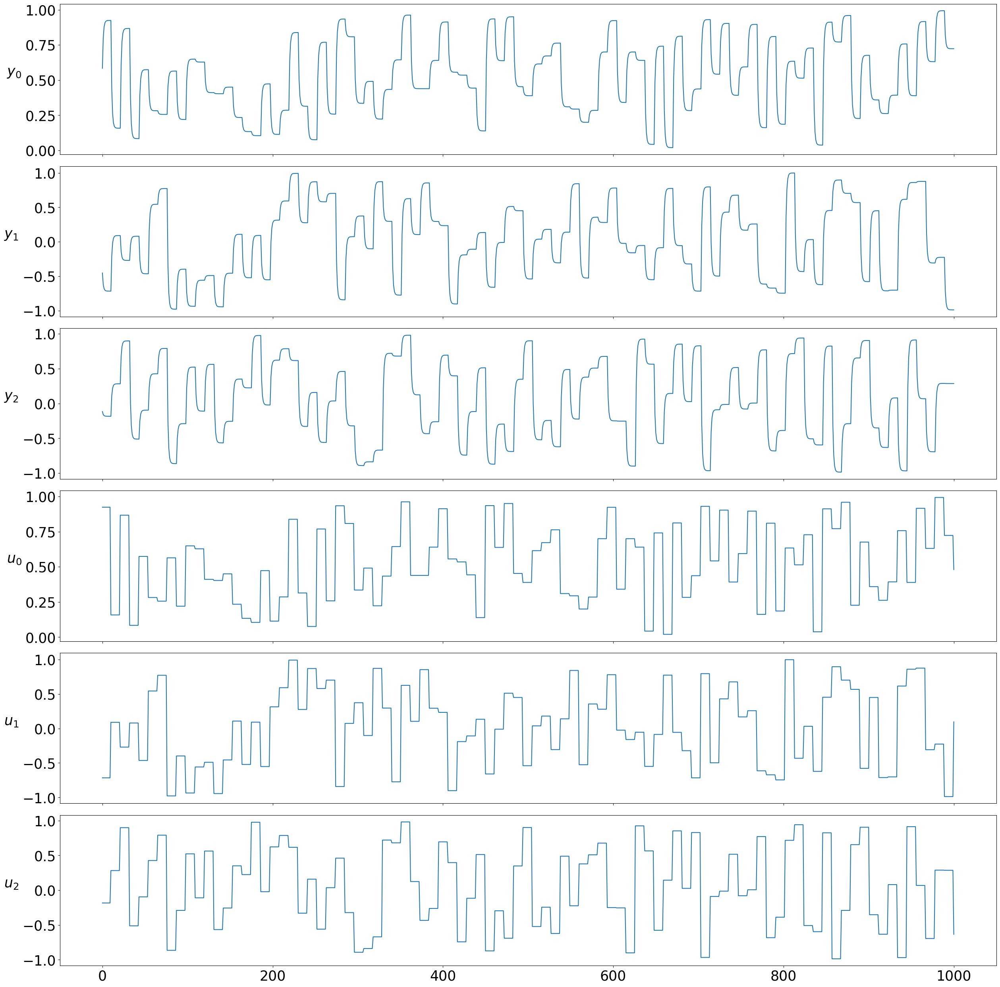

CSTR


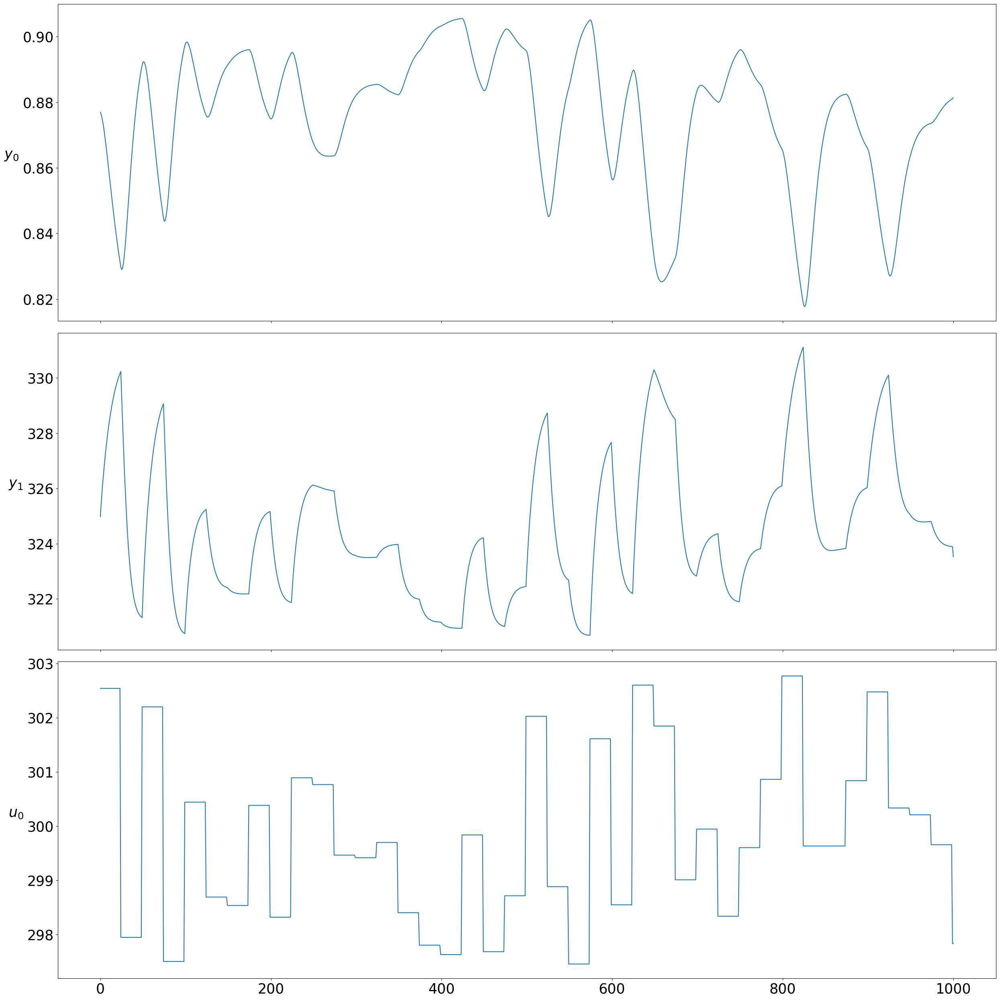

DuffingControl


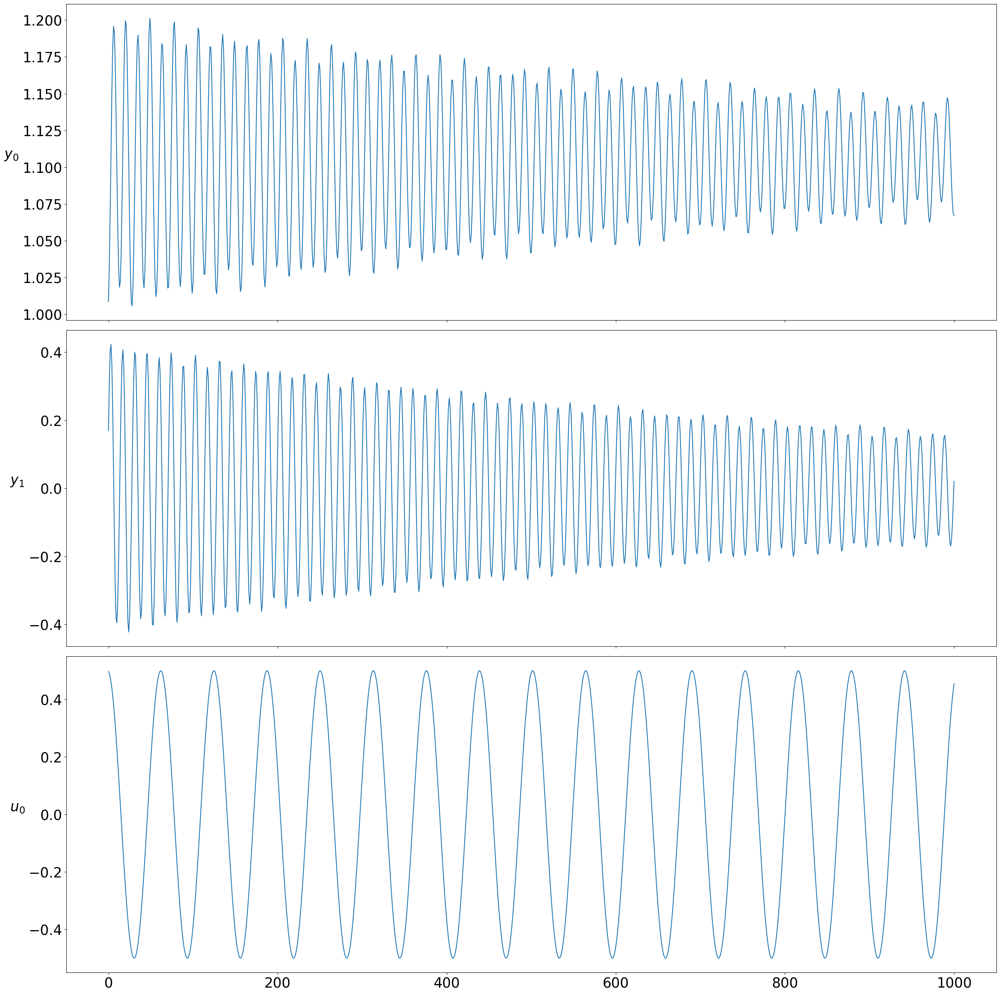

HindmarshRose


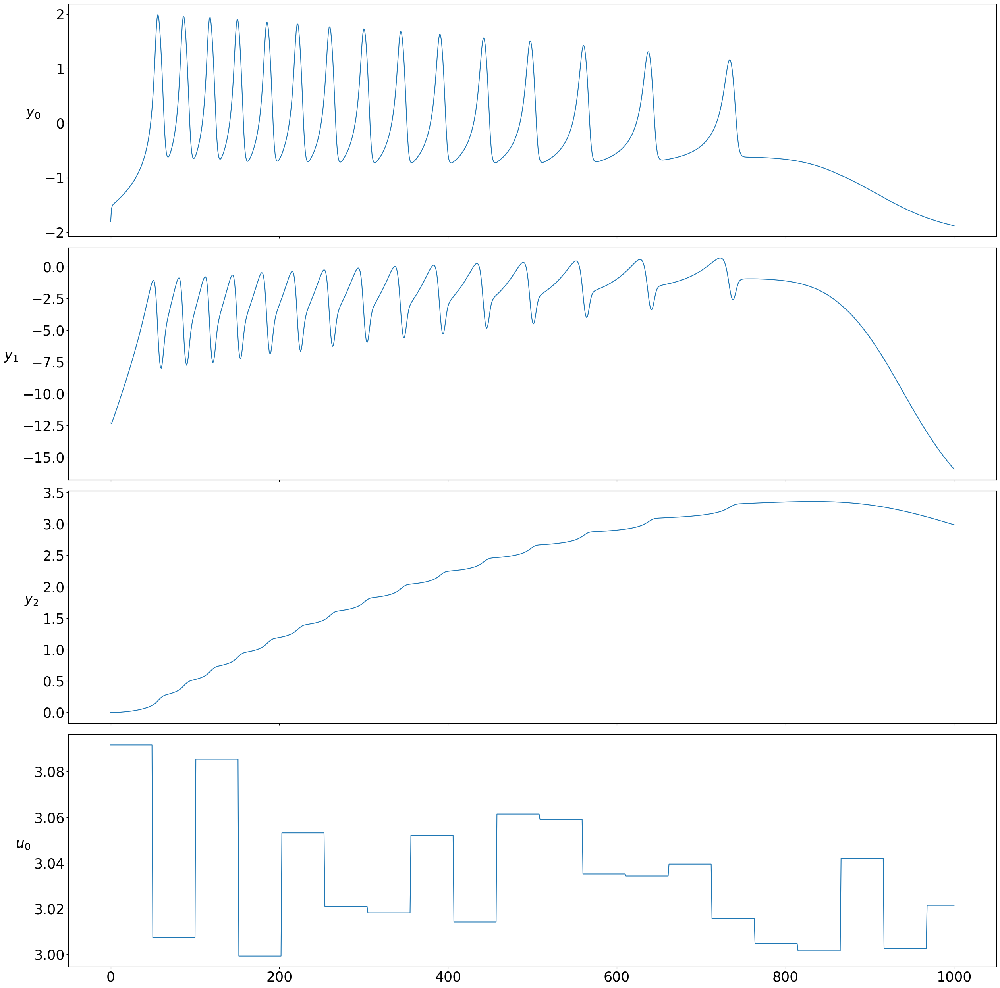

InvPendulum


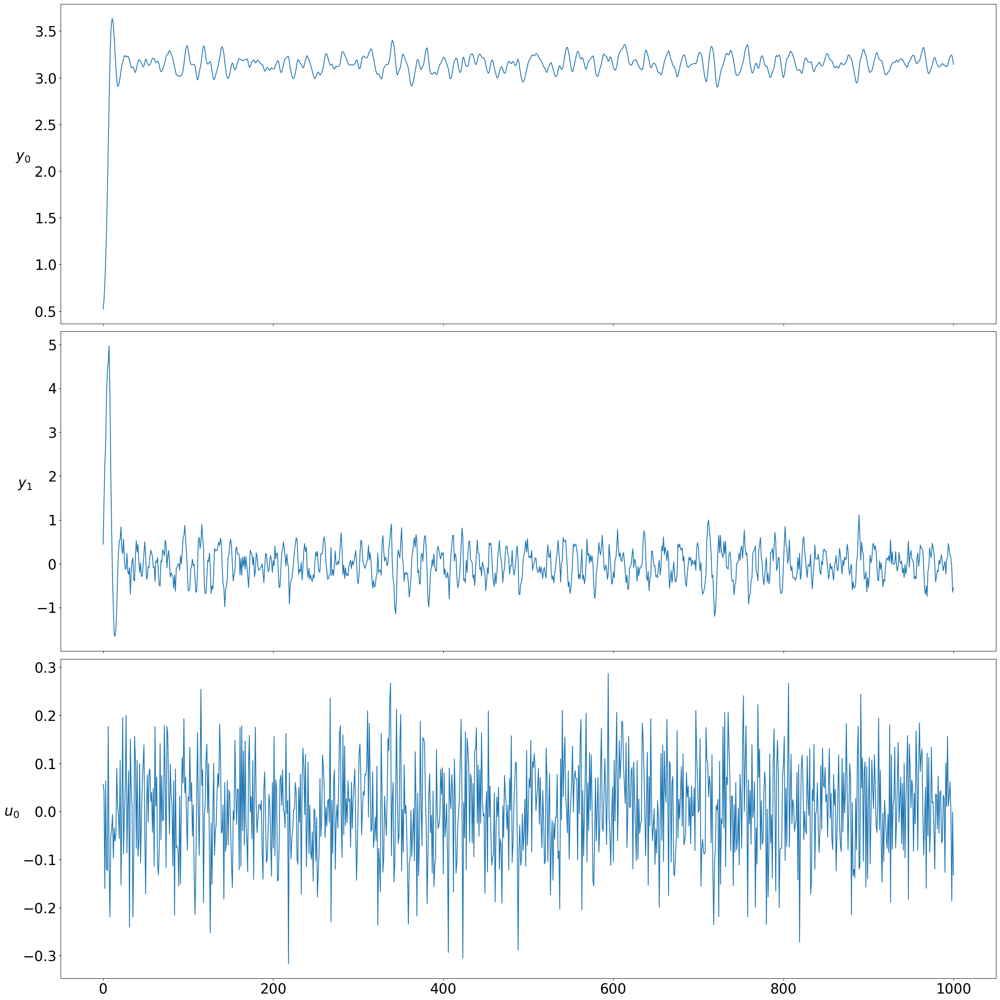

IverSimple


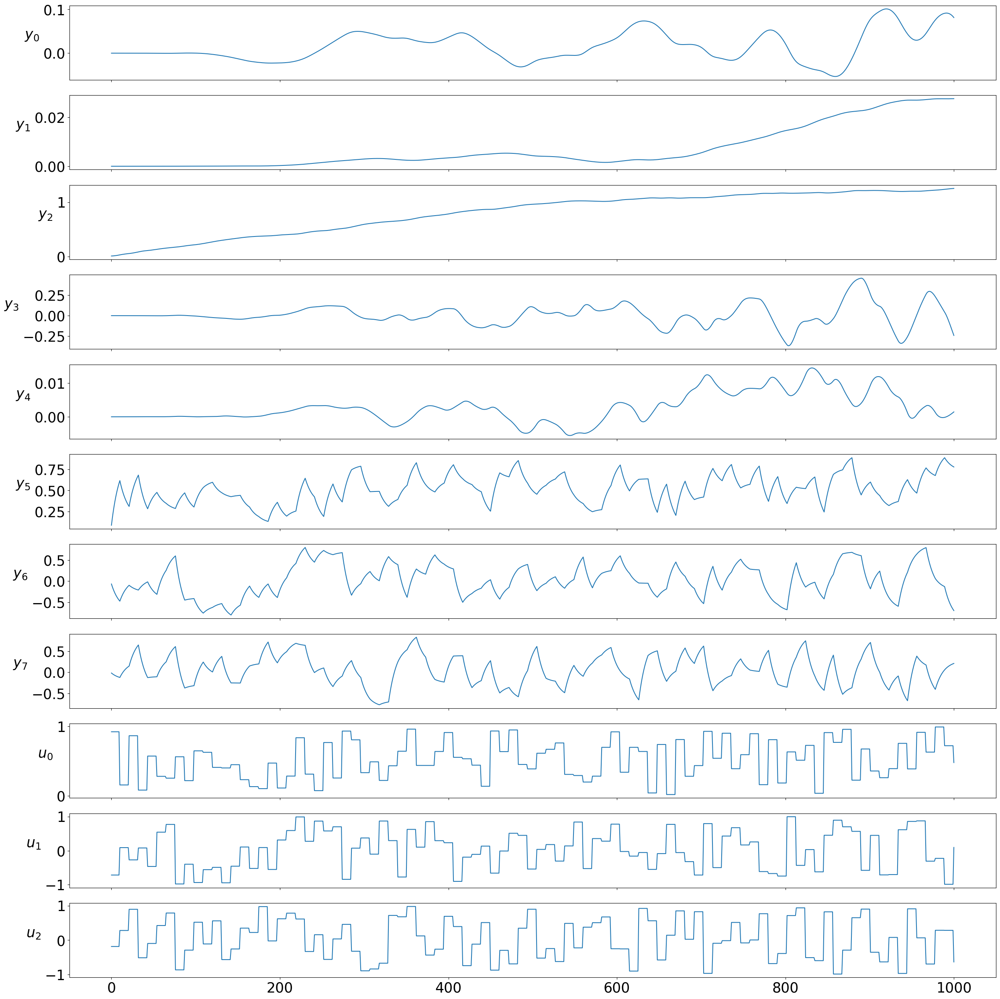

LorenzControl


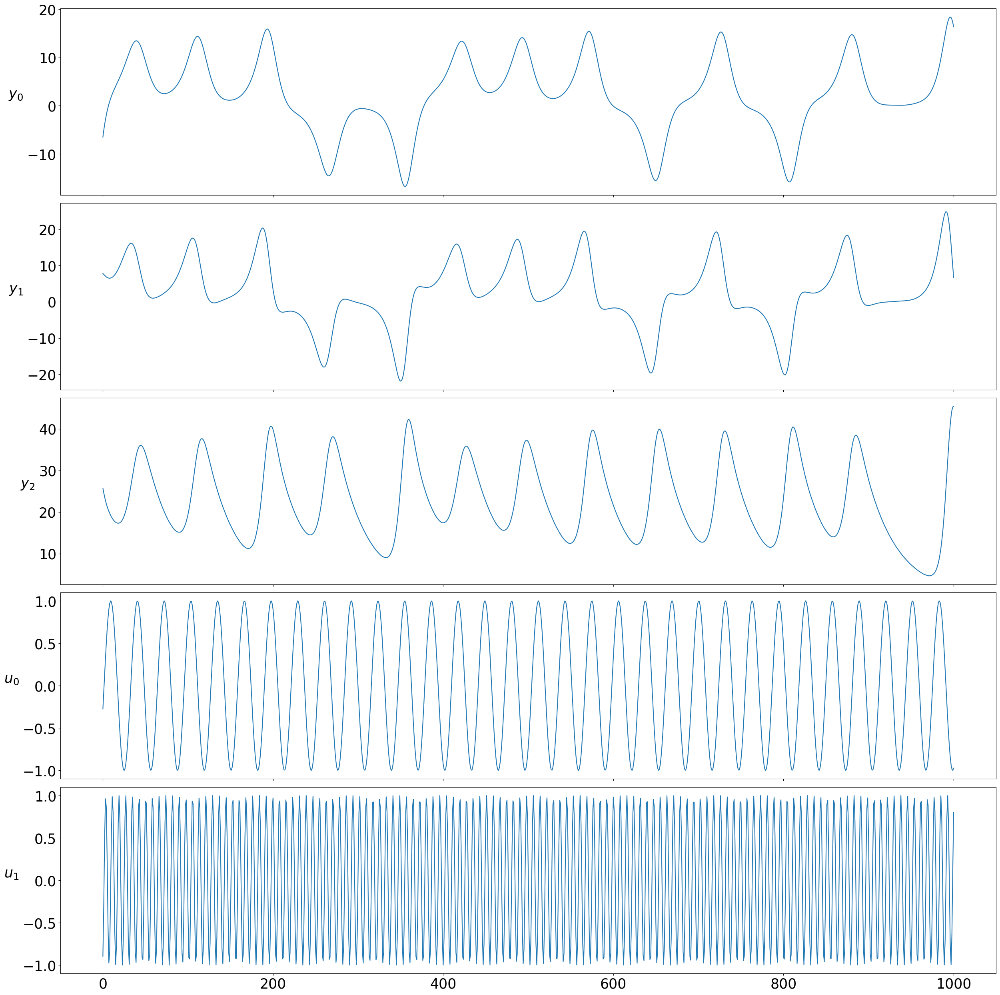

SEIR_population


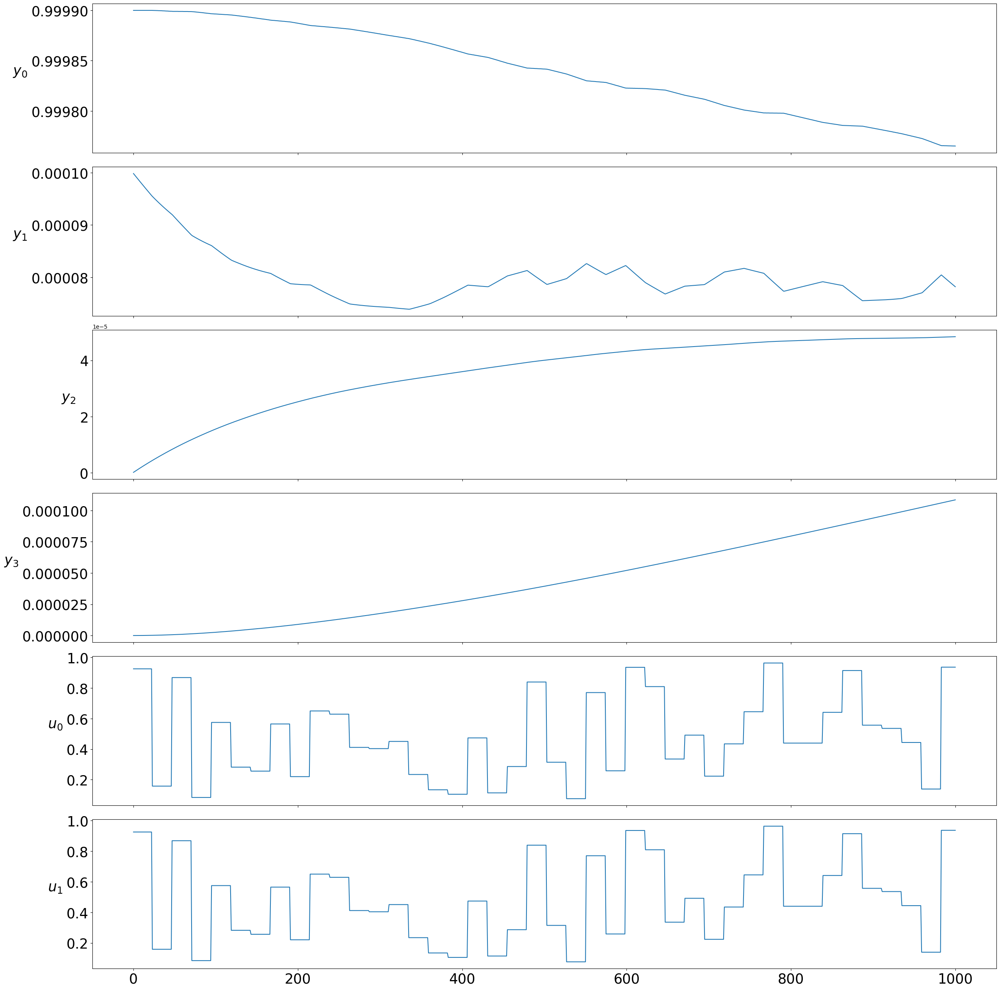

SwingEquation


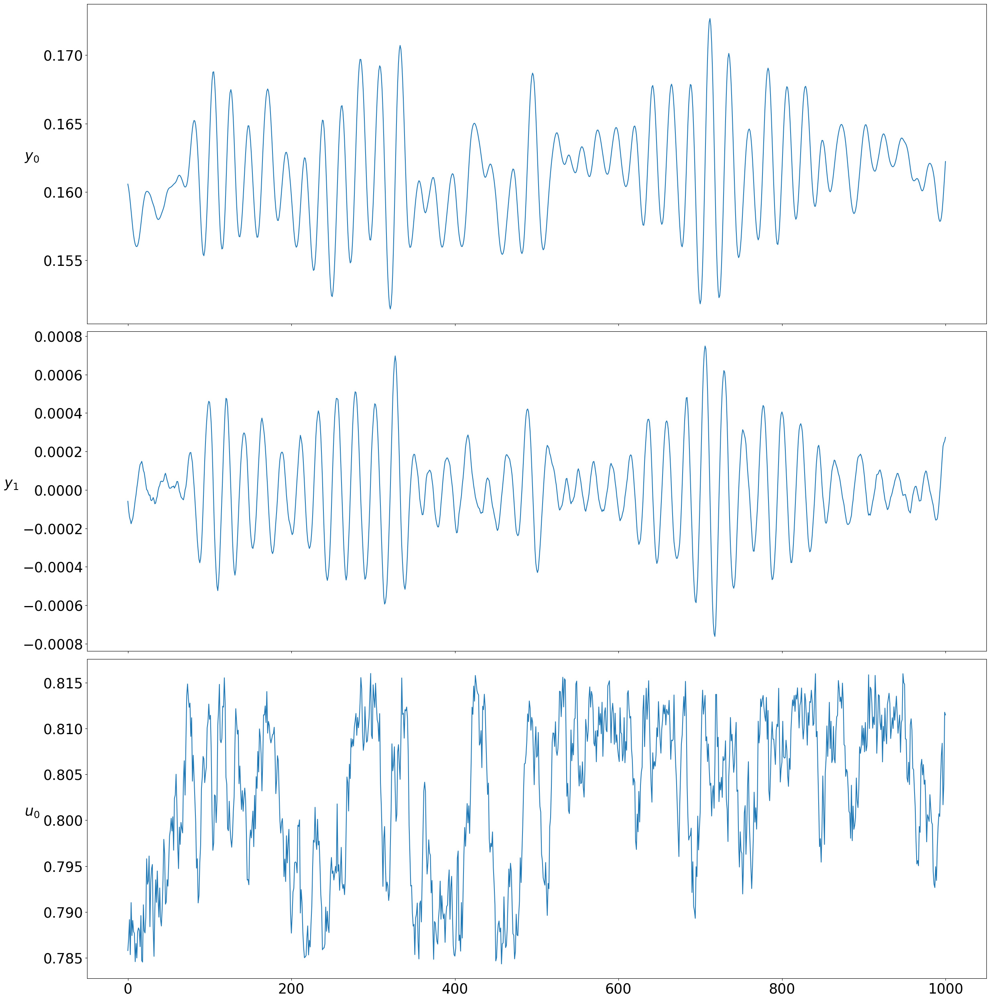

Tank


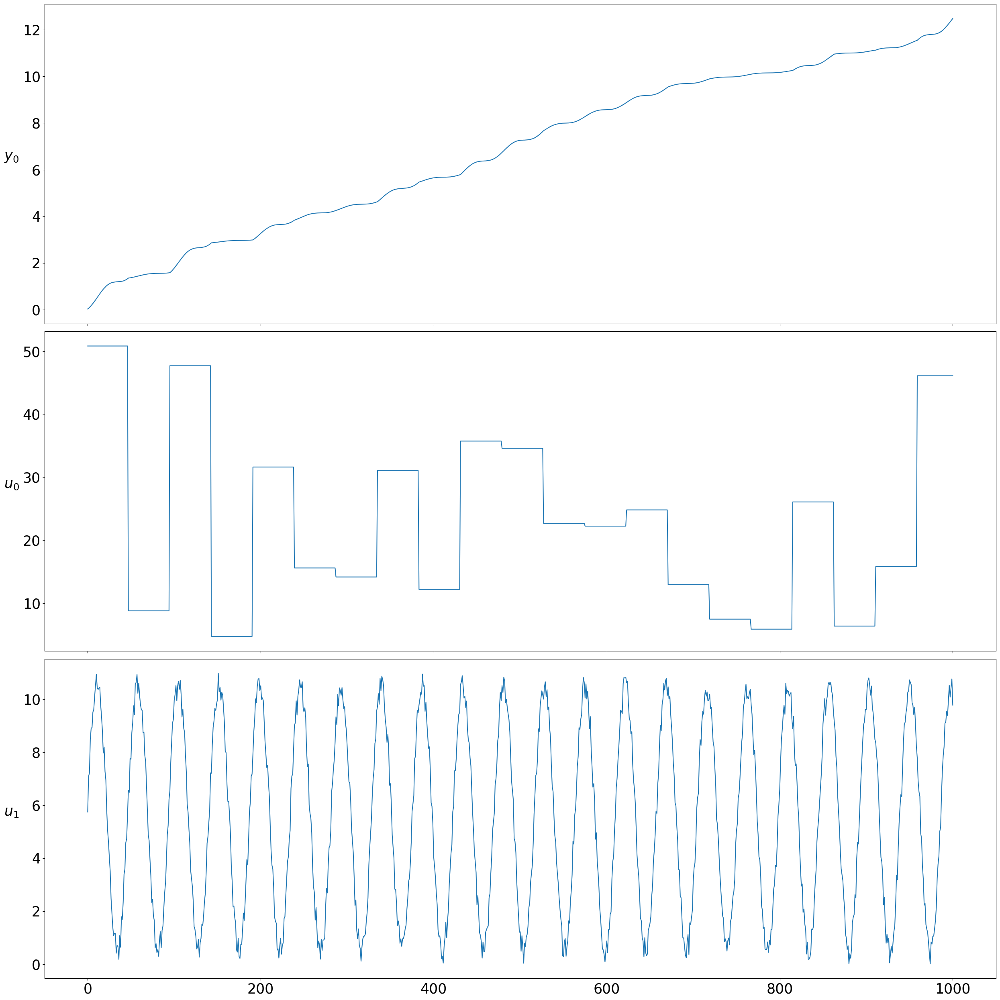

ThomasAttractorControl


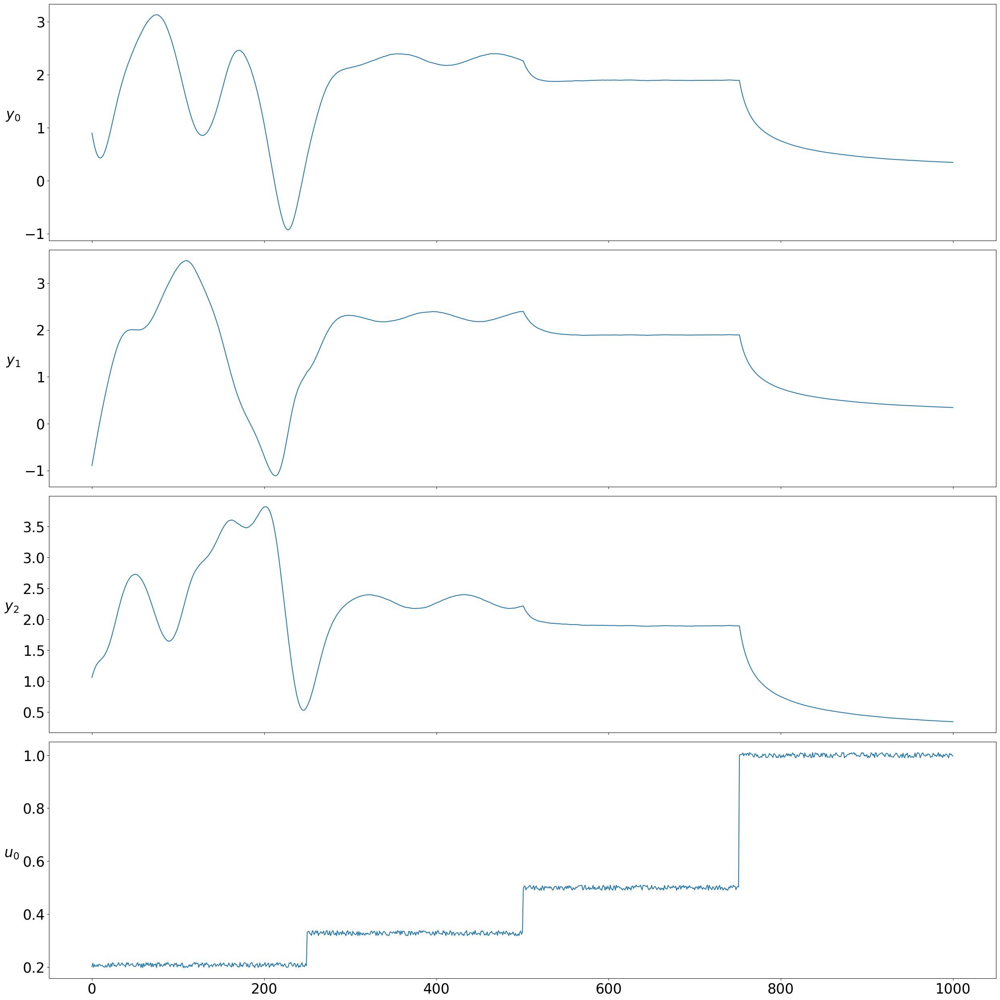

TwoTank


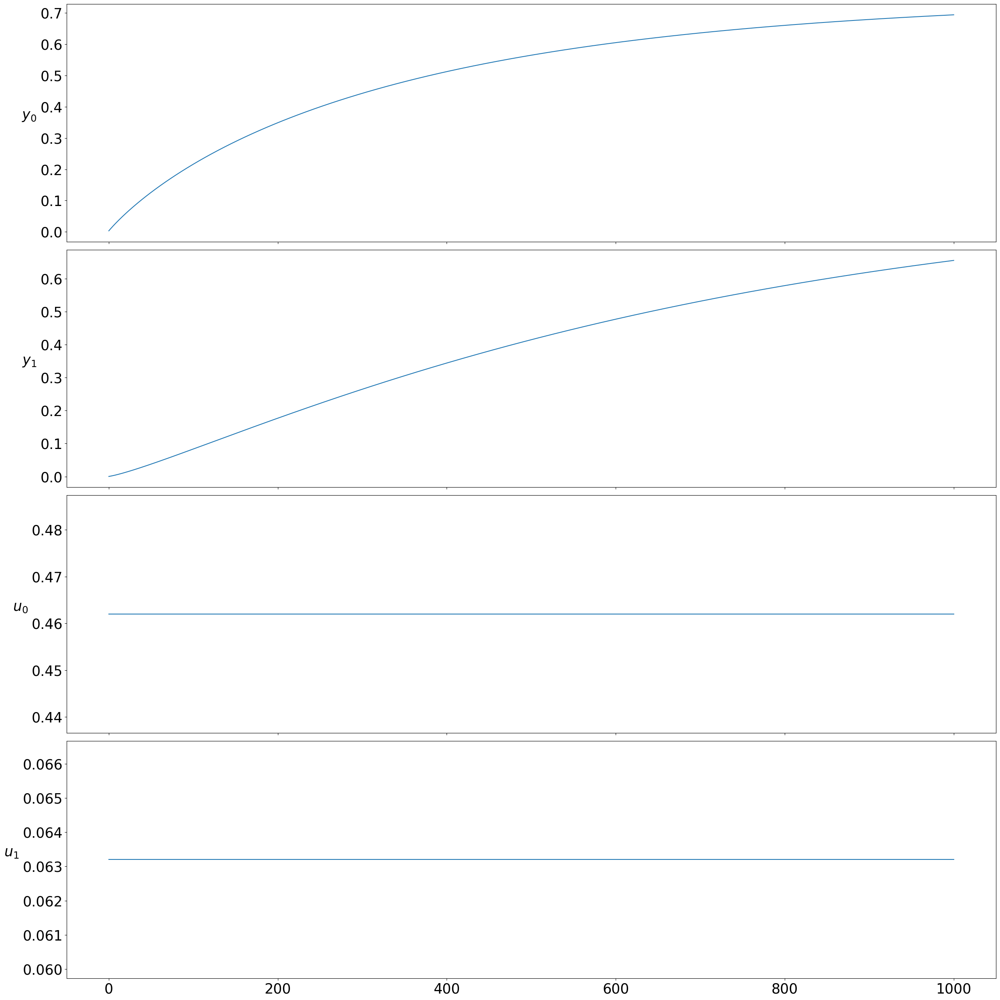

VanDerPolControl


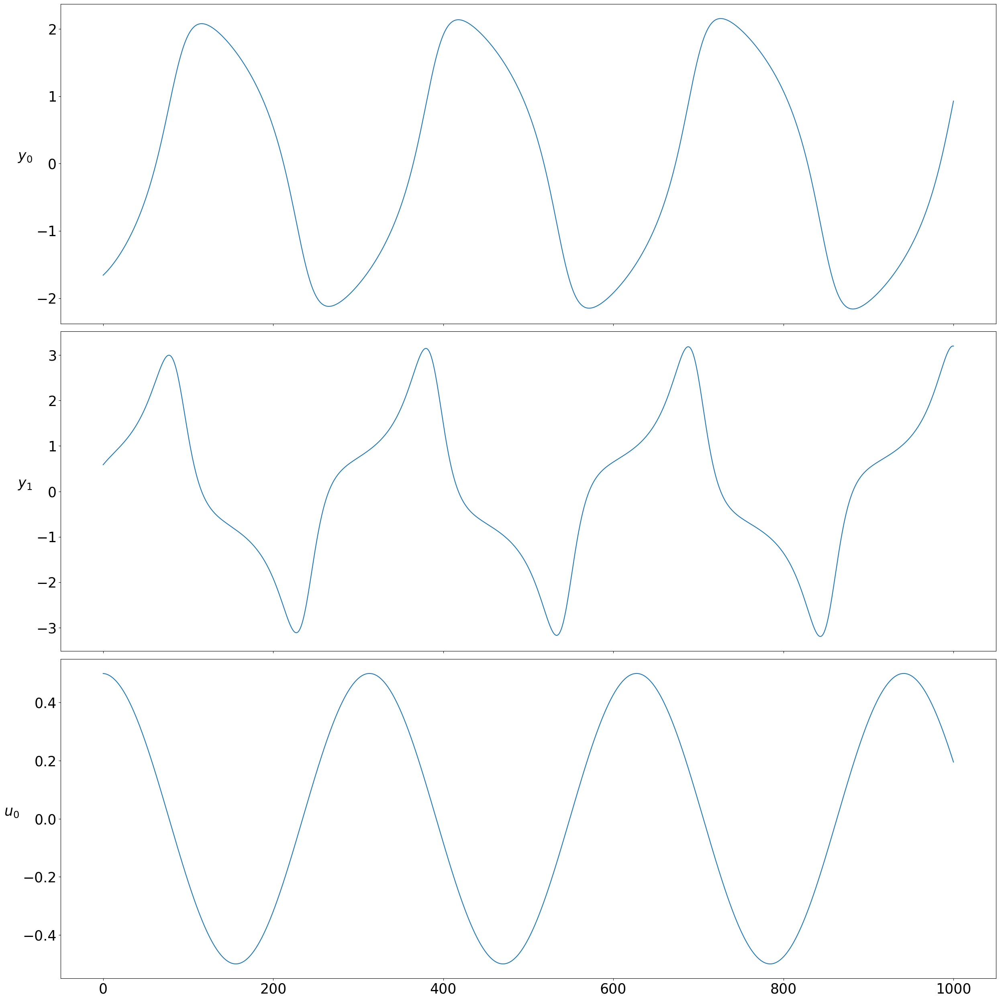

SimpleSingleZone


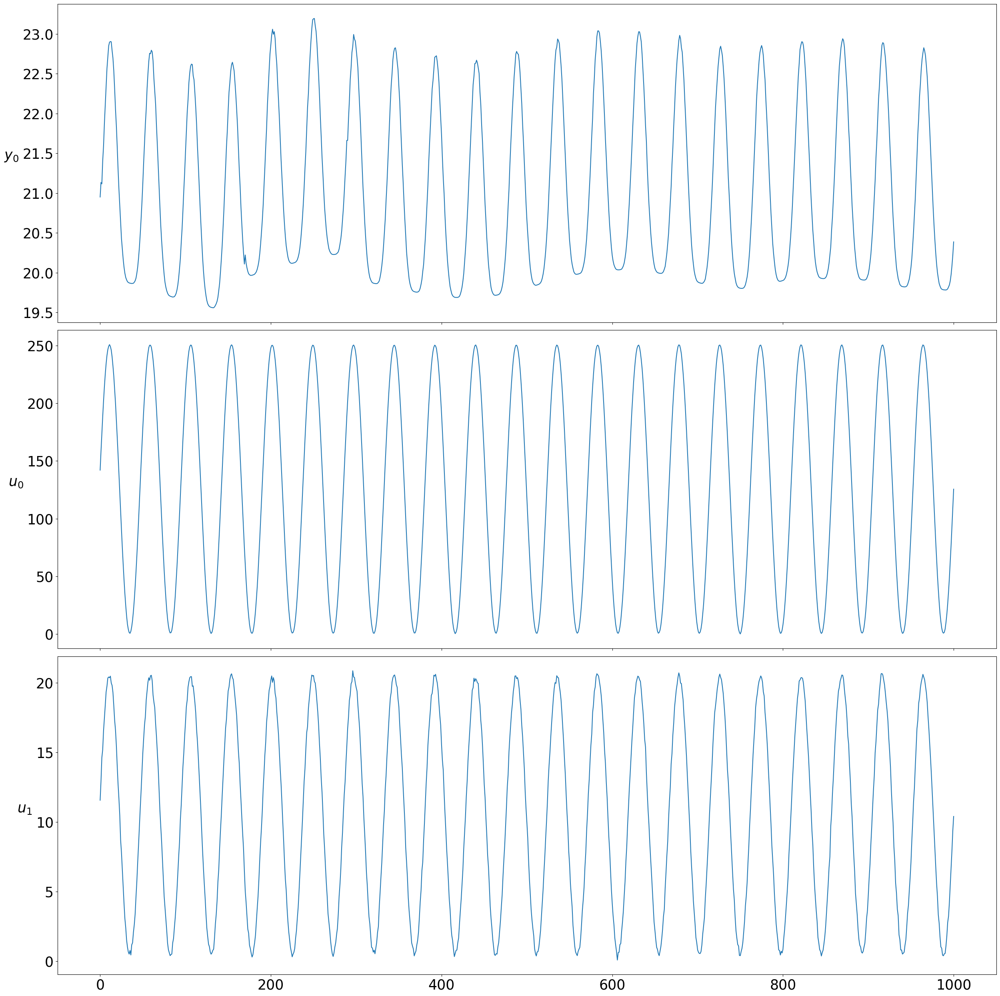

Reno_full


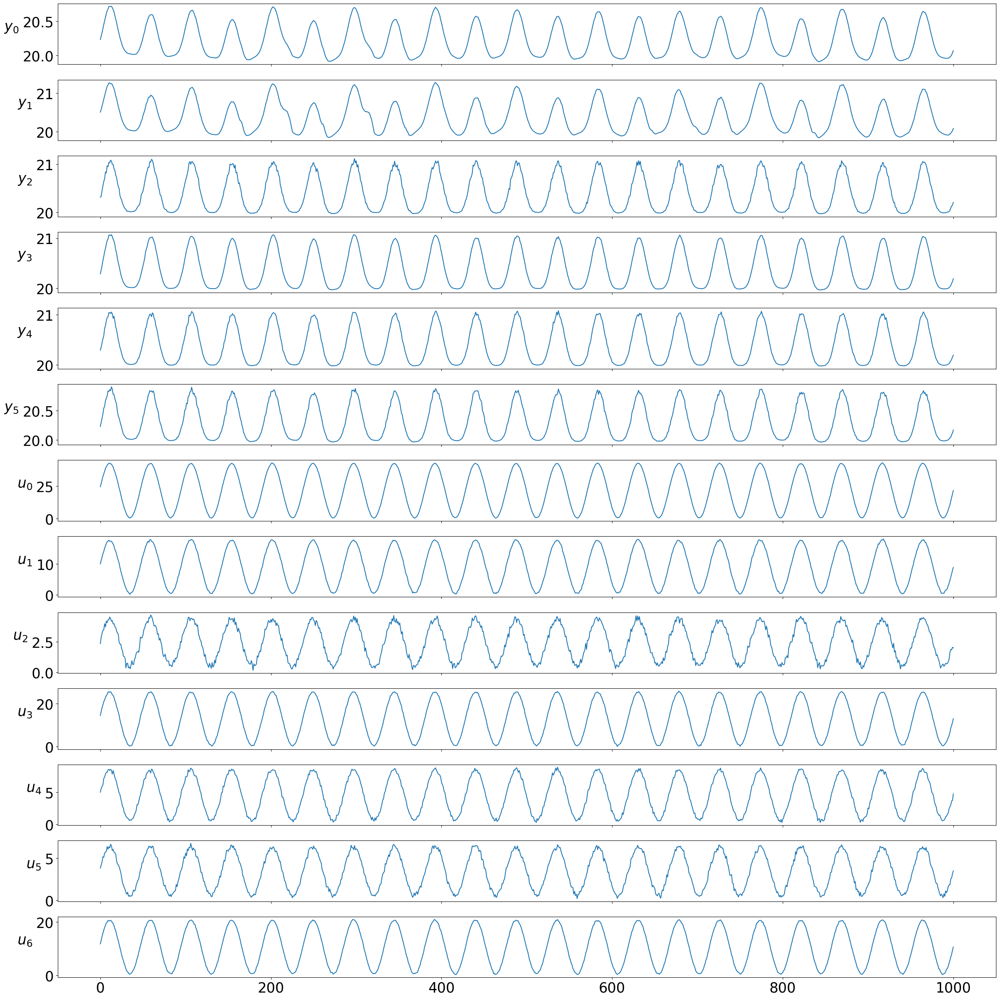

Reno_ROM40


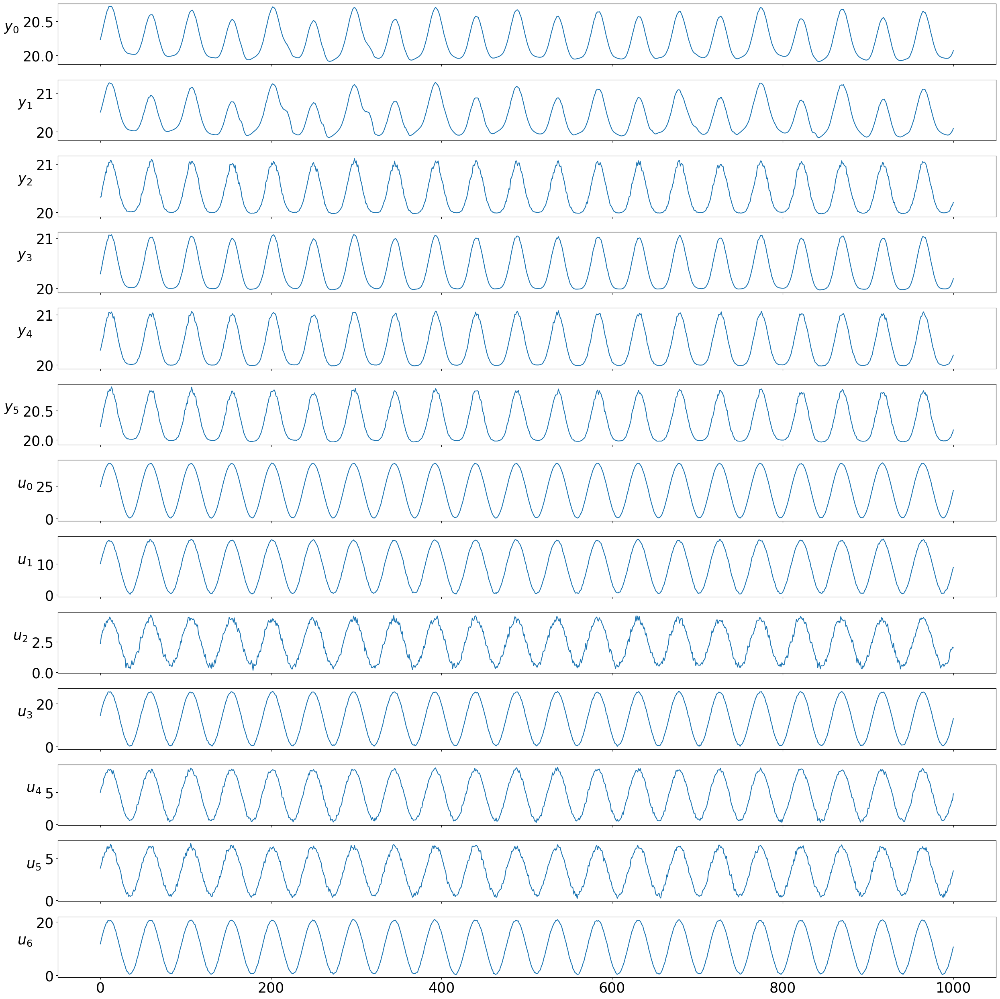

RenoLight_full


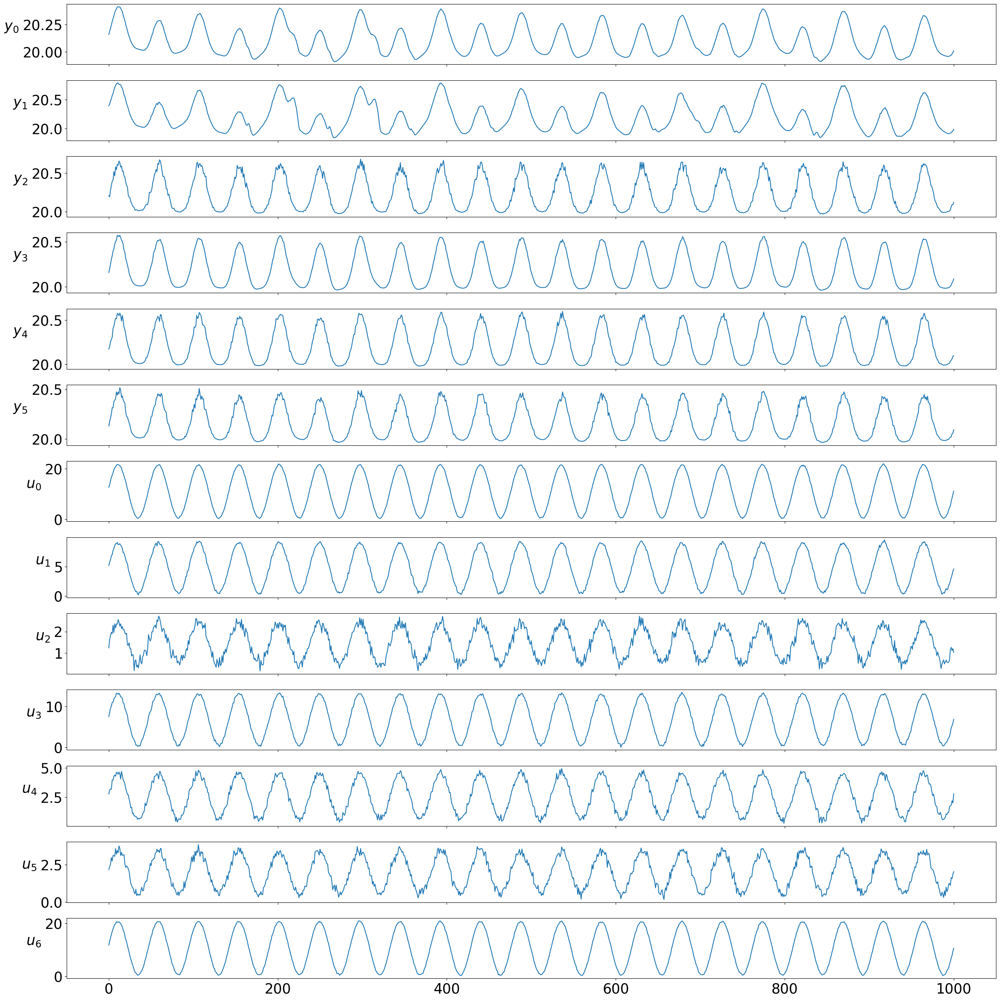

RenoLight_ROM40


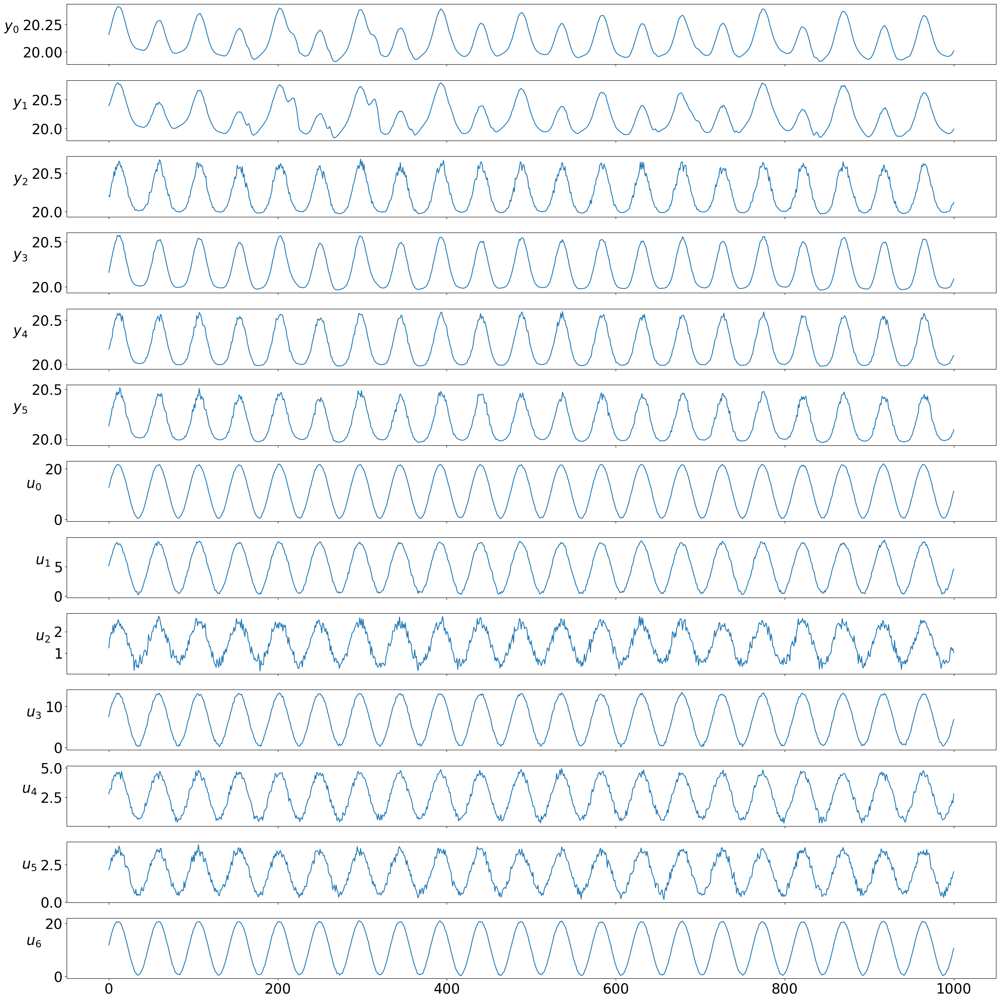

Old_full


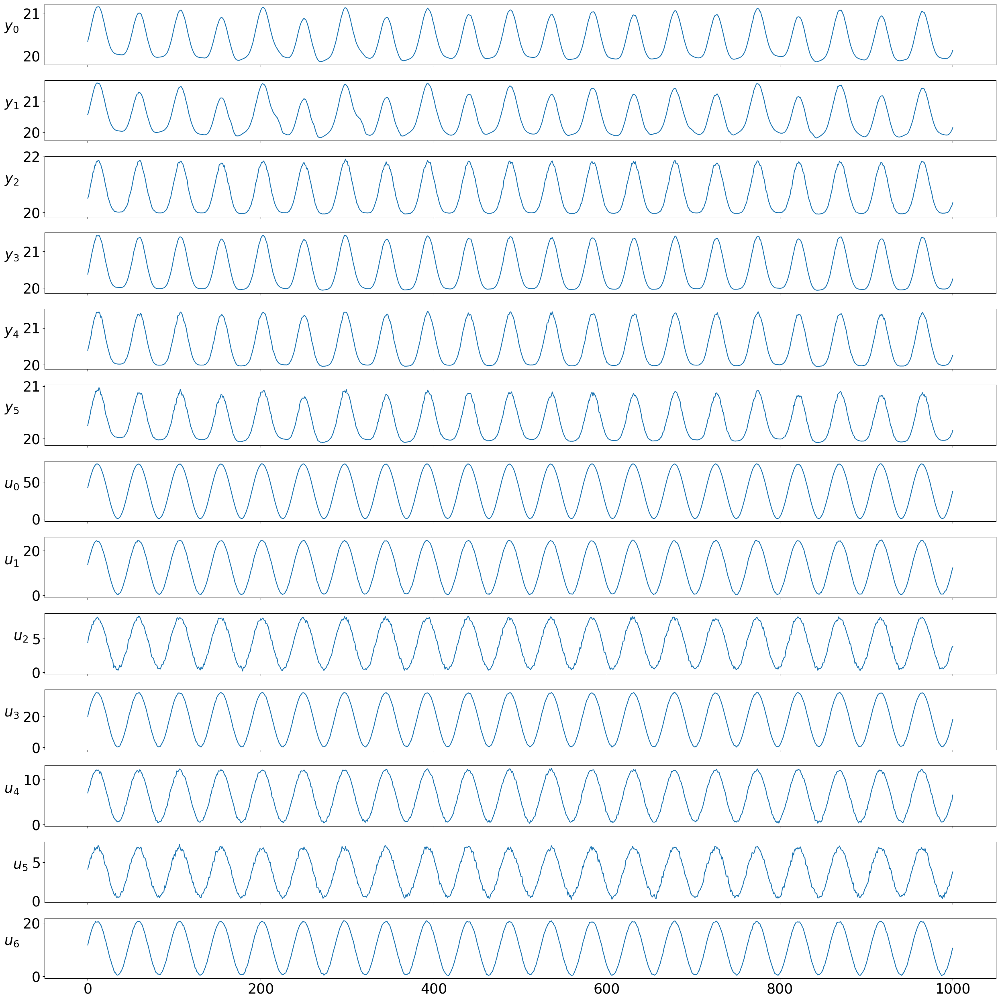

Old_ROM40


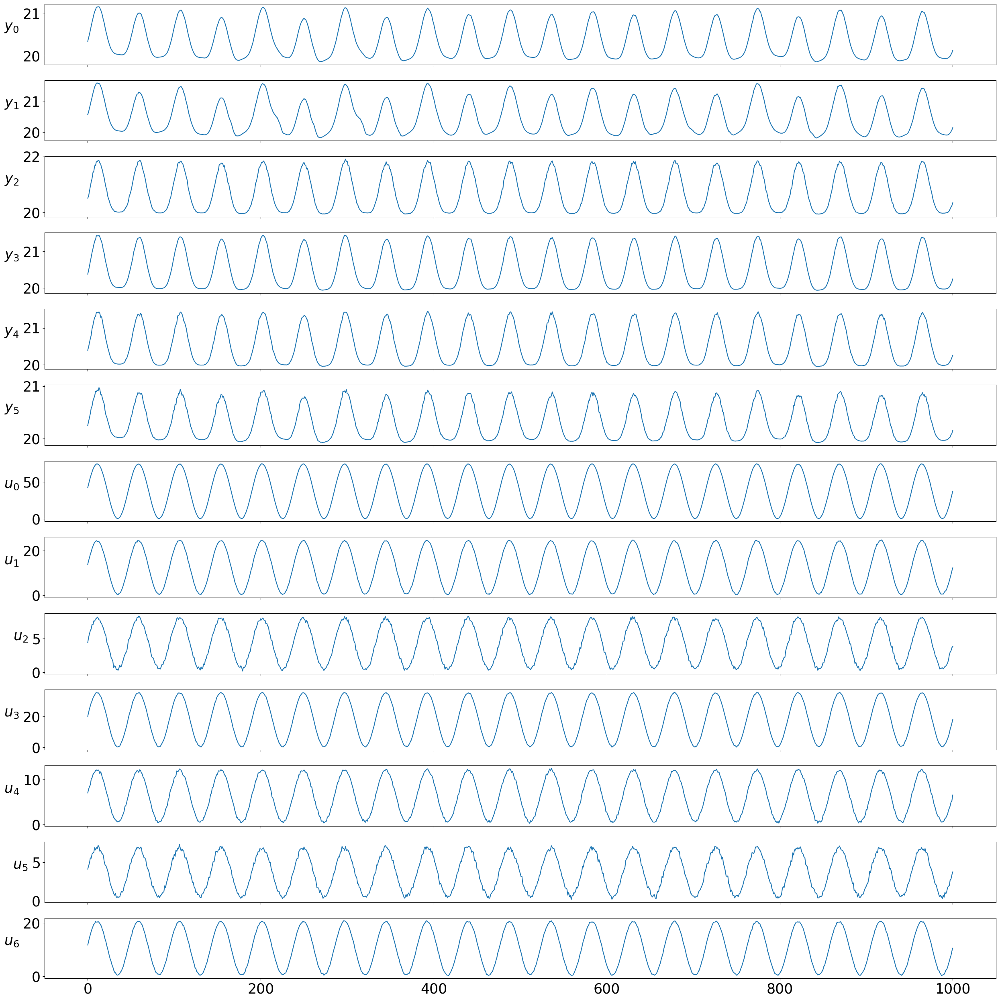

HollandschHuys_full


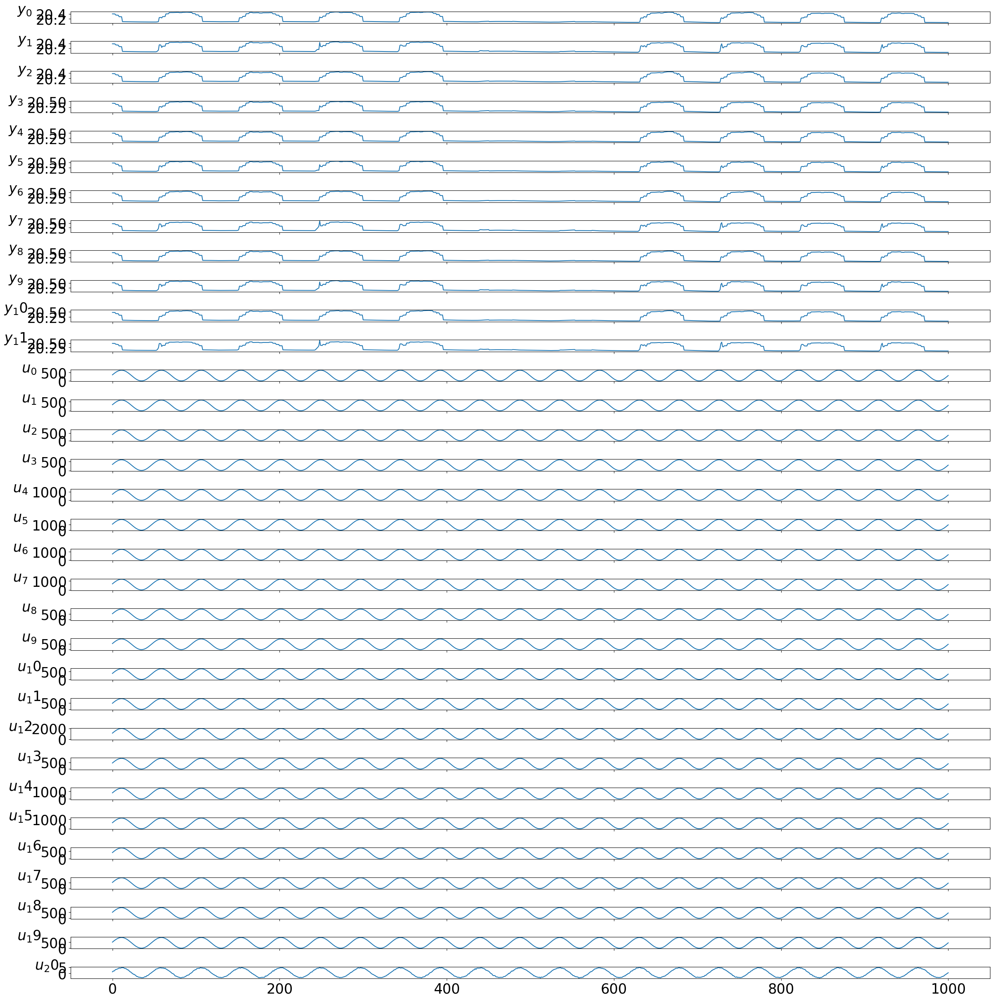

HollandschHuys_ROM100


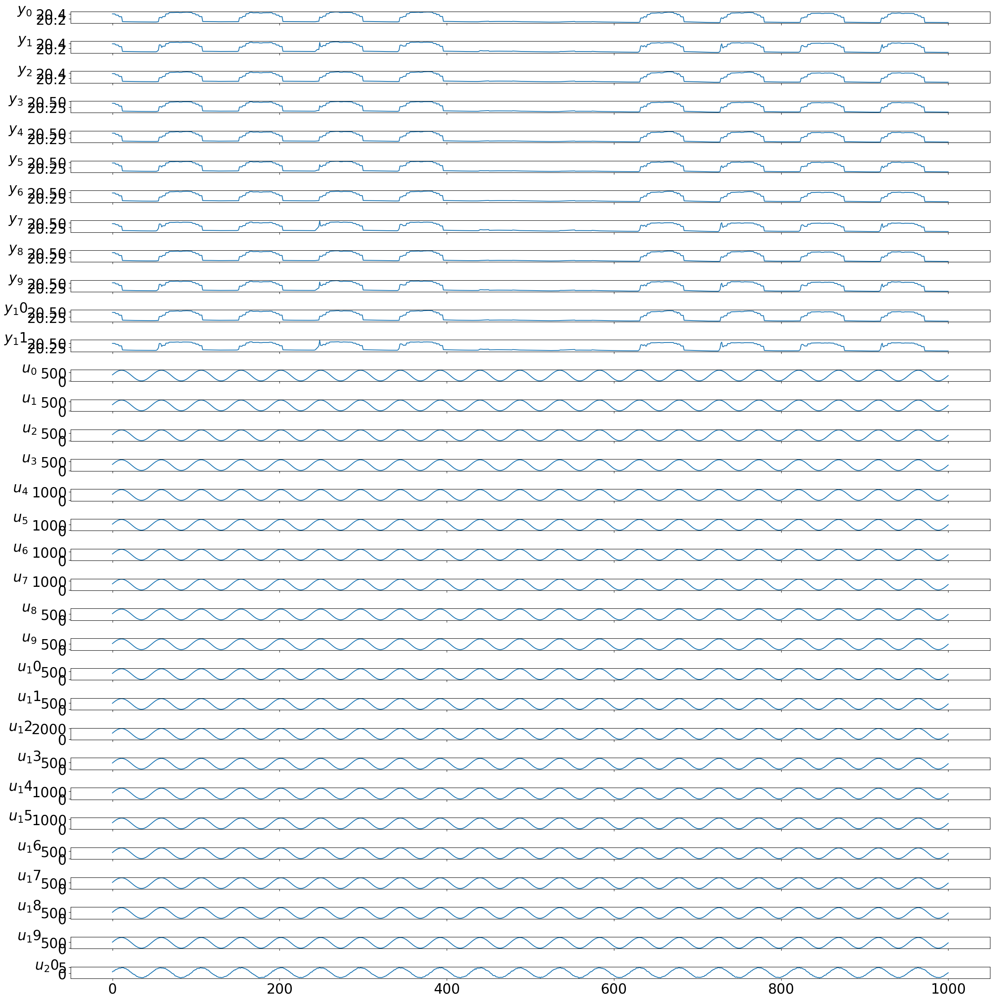

Infrax_full


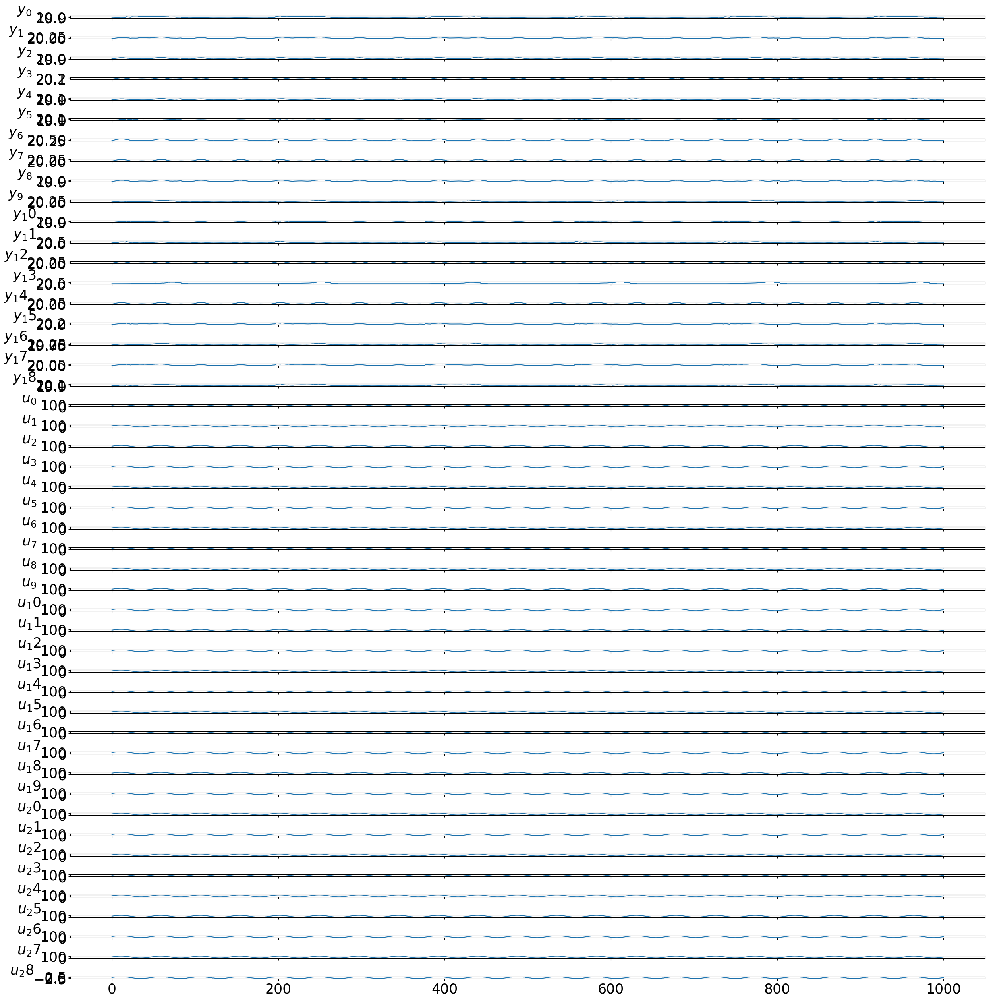

Infrax_ROM100


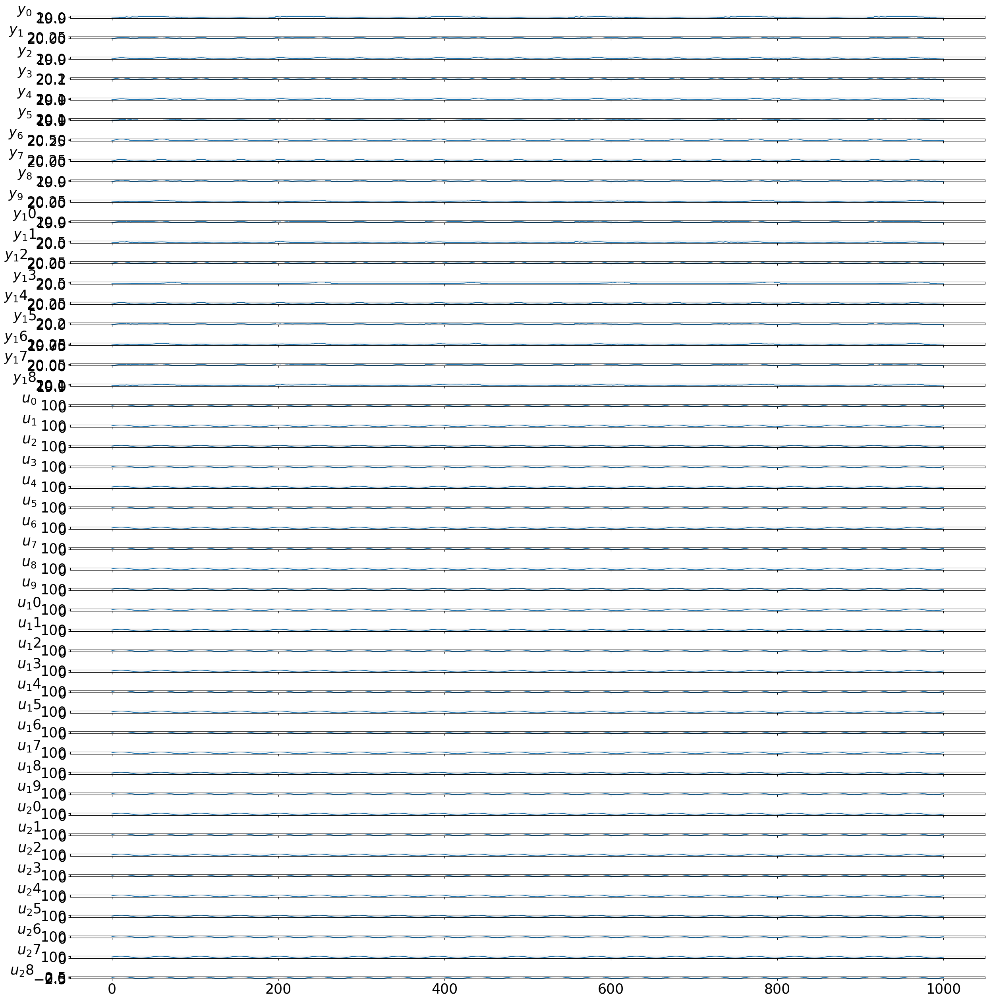

LinearSimpleSingleZone


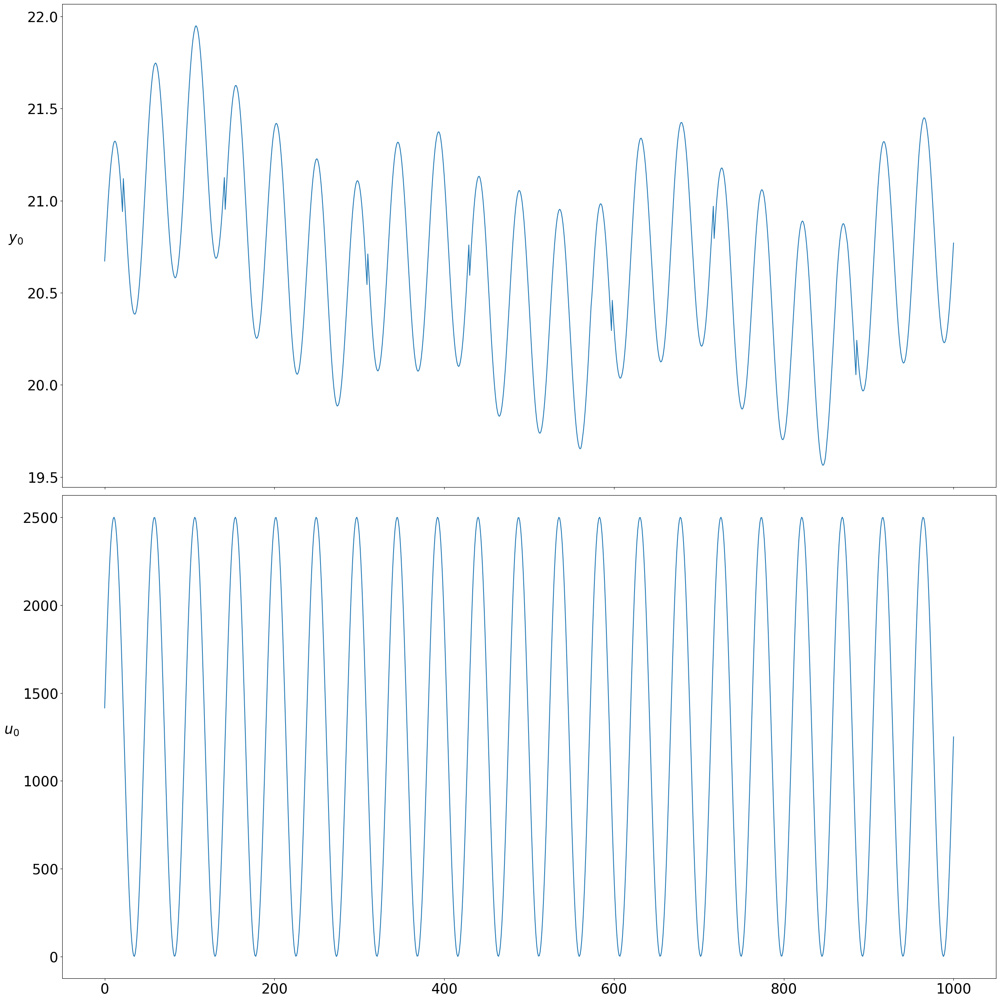

LinearReno_full


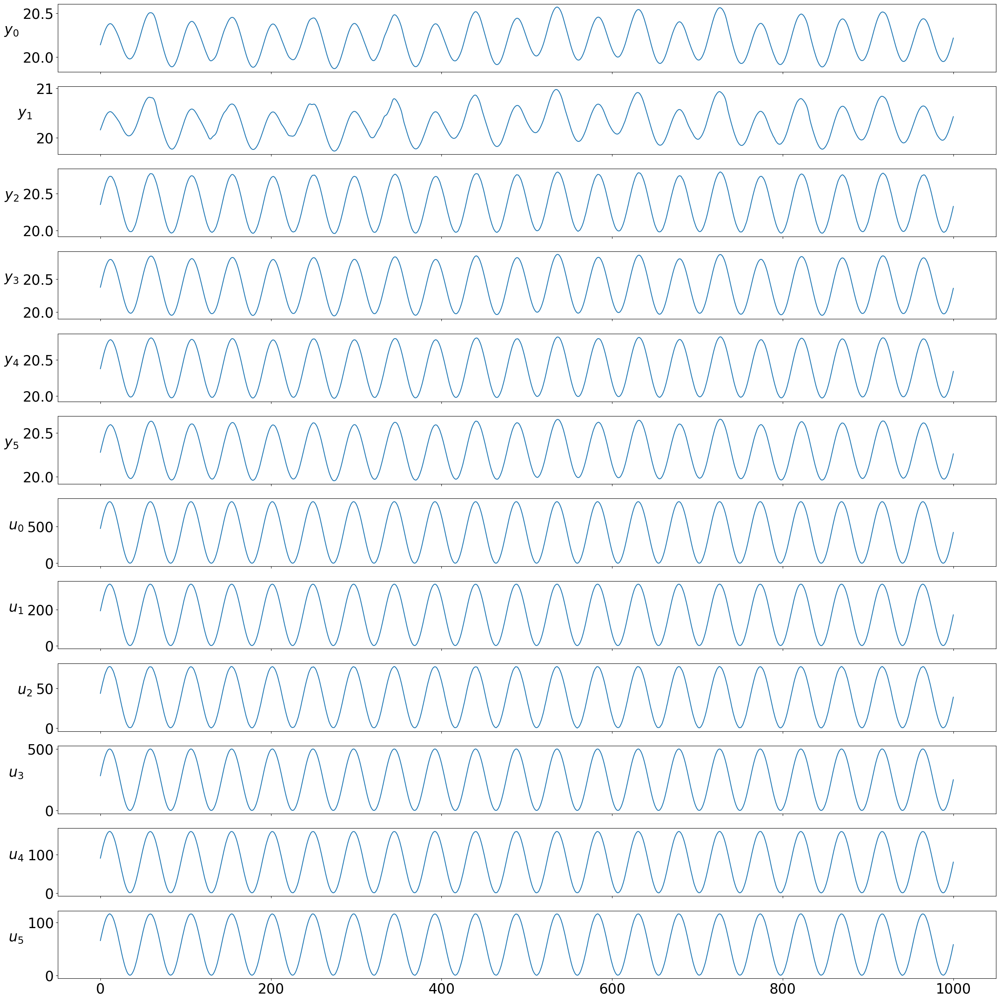

LinearReno_ROM40


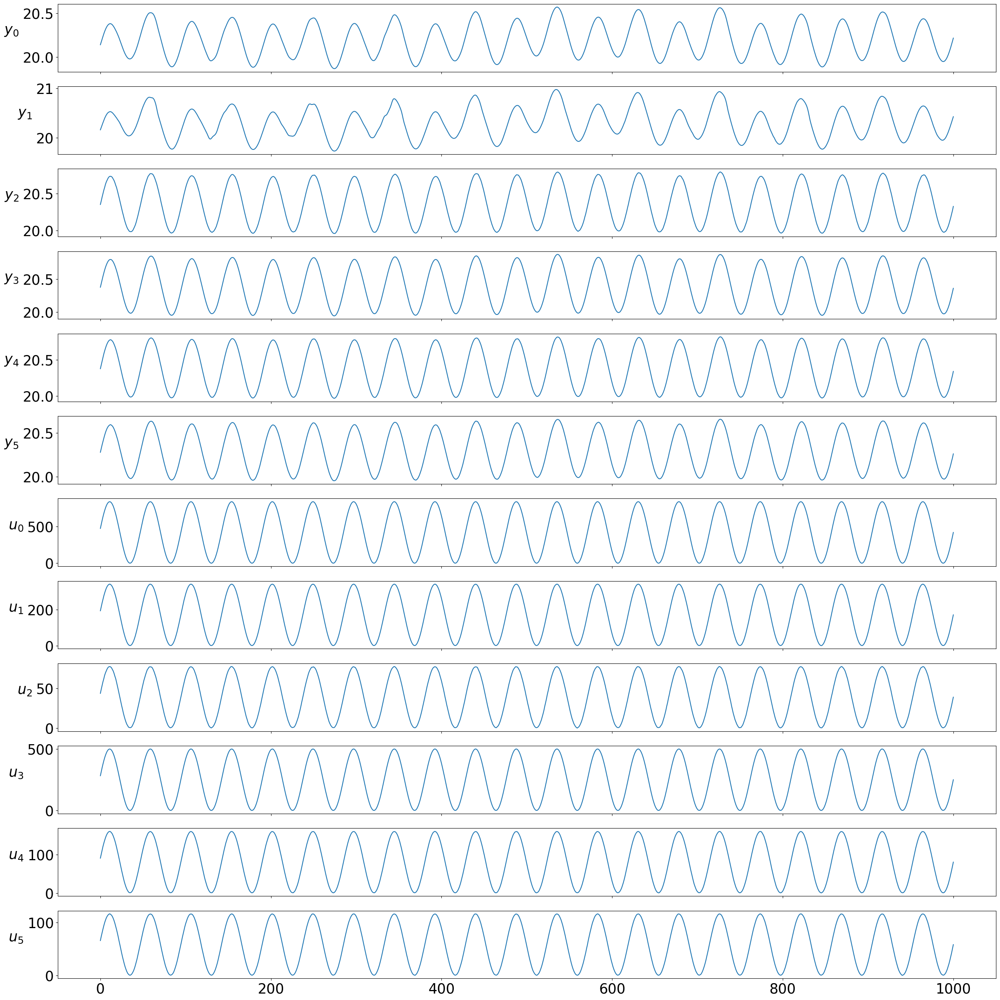

LinearRenoLight_full


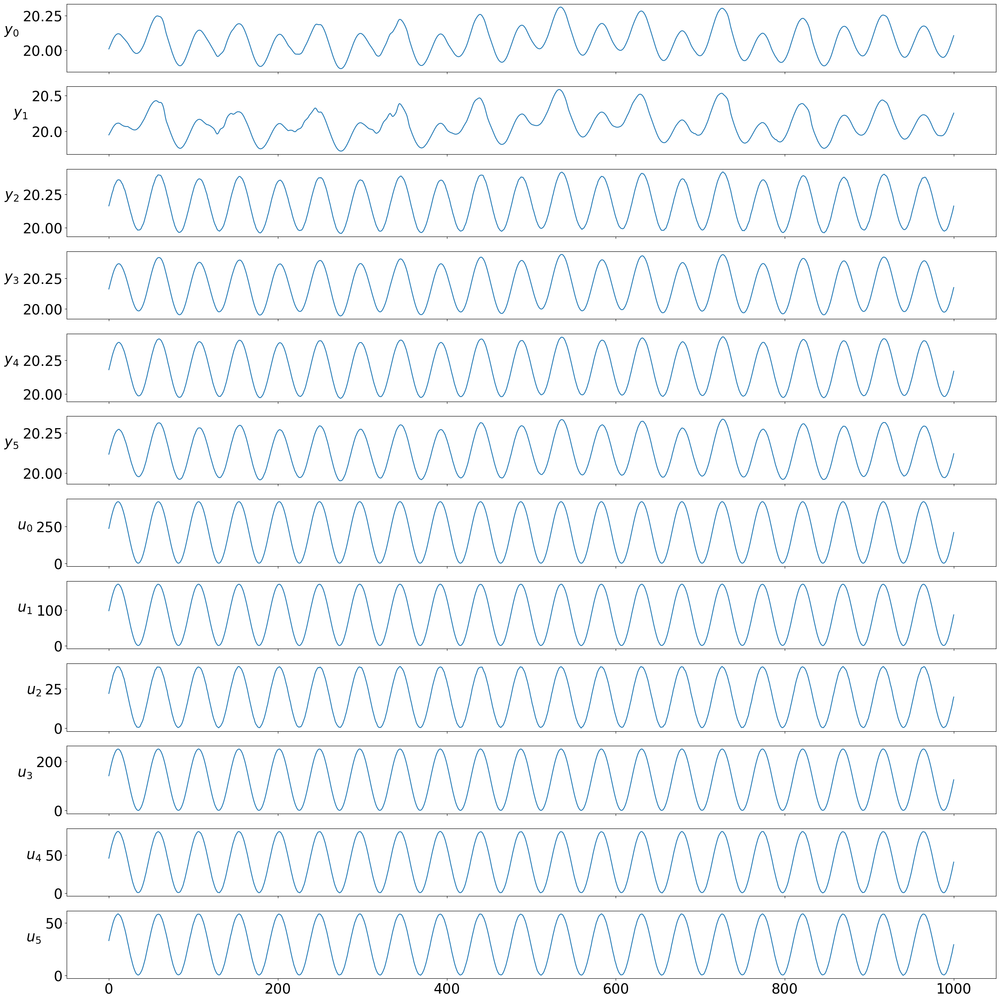

LinearRenoLight_ROM40


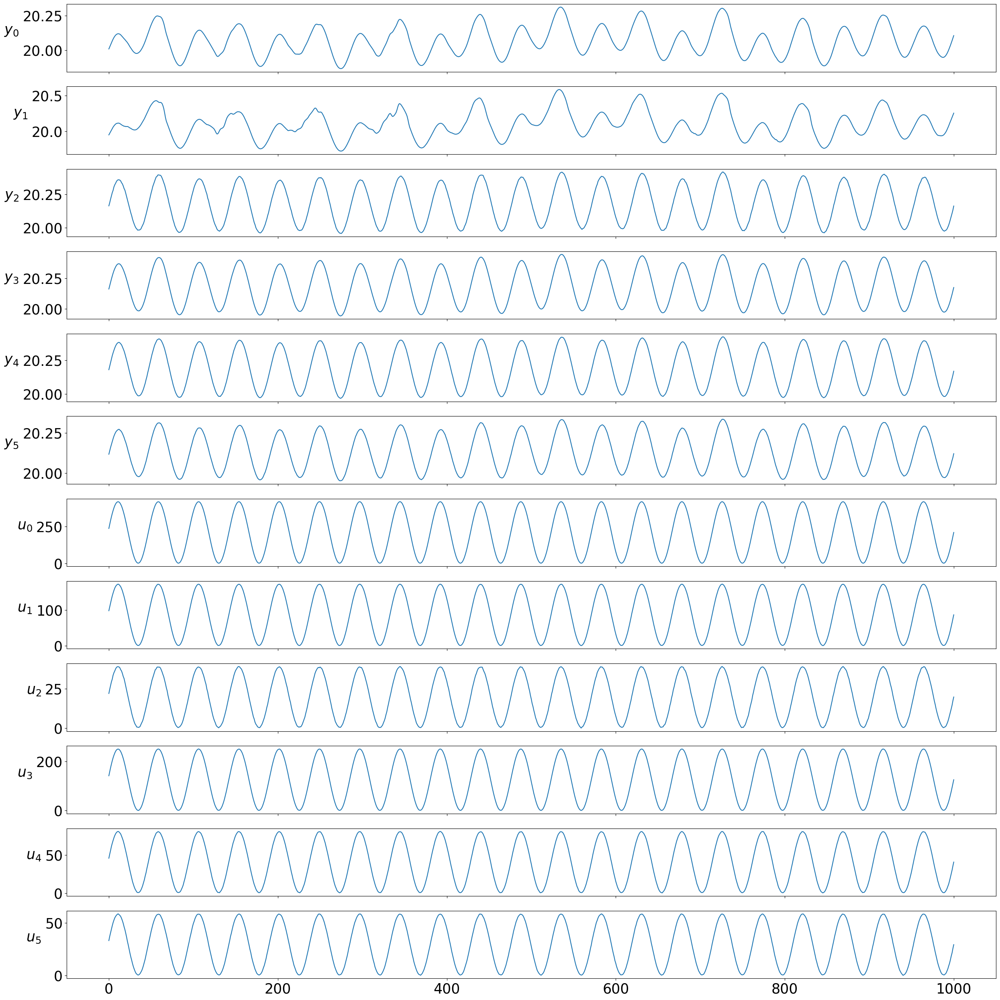

LinearOld_full


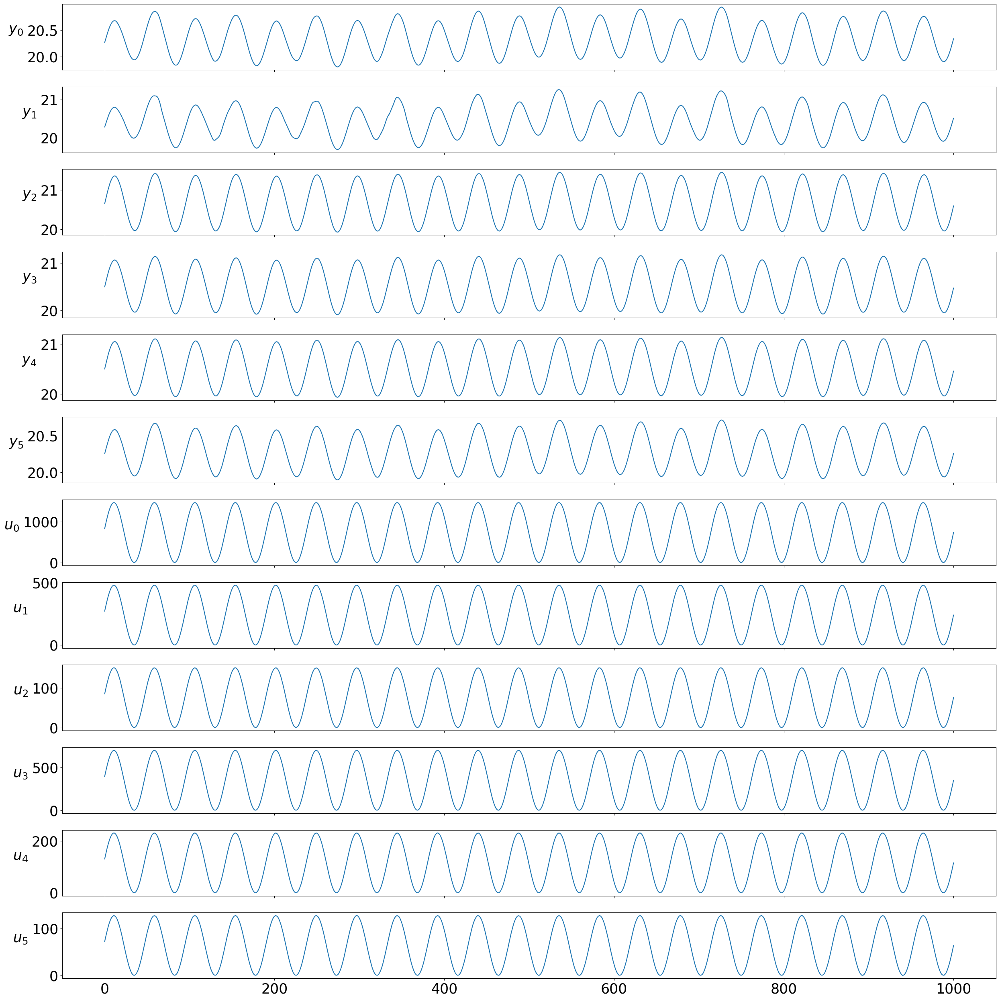

LinearOld_ROM40


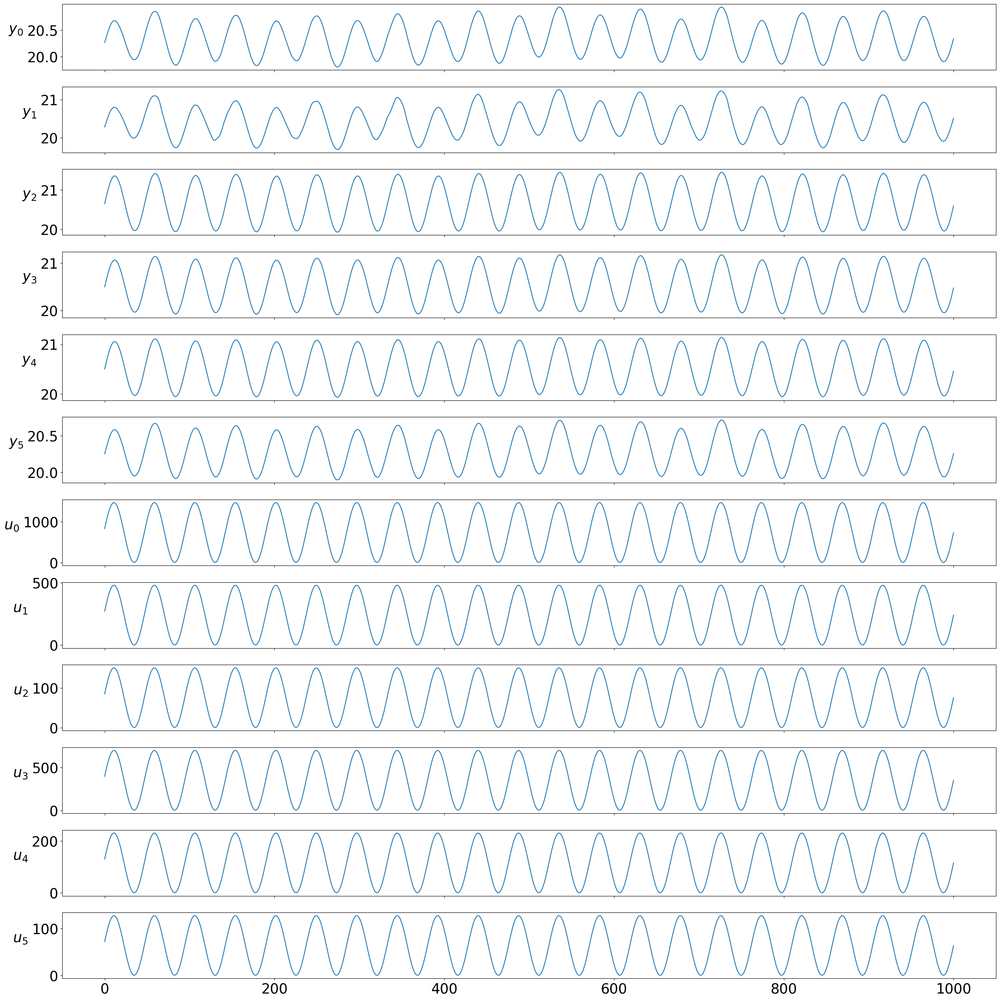

LinearHollandschHuys_full


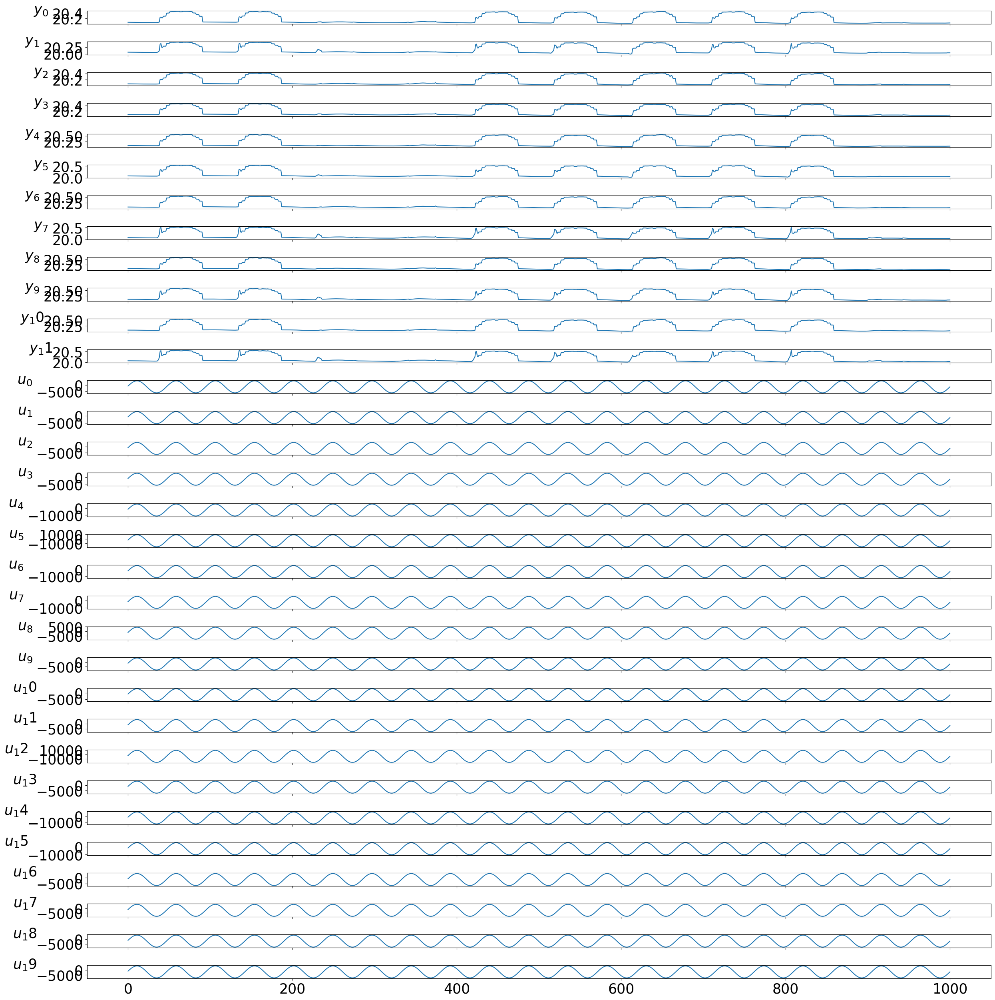

LinearHollandschHuys_ROM100


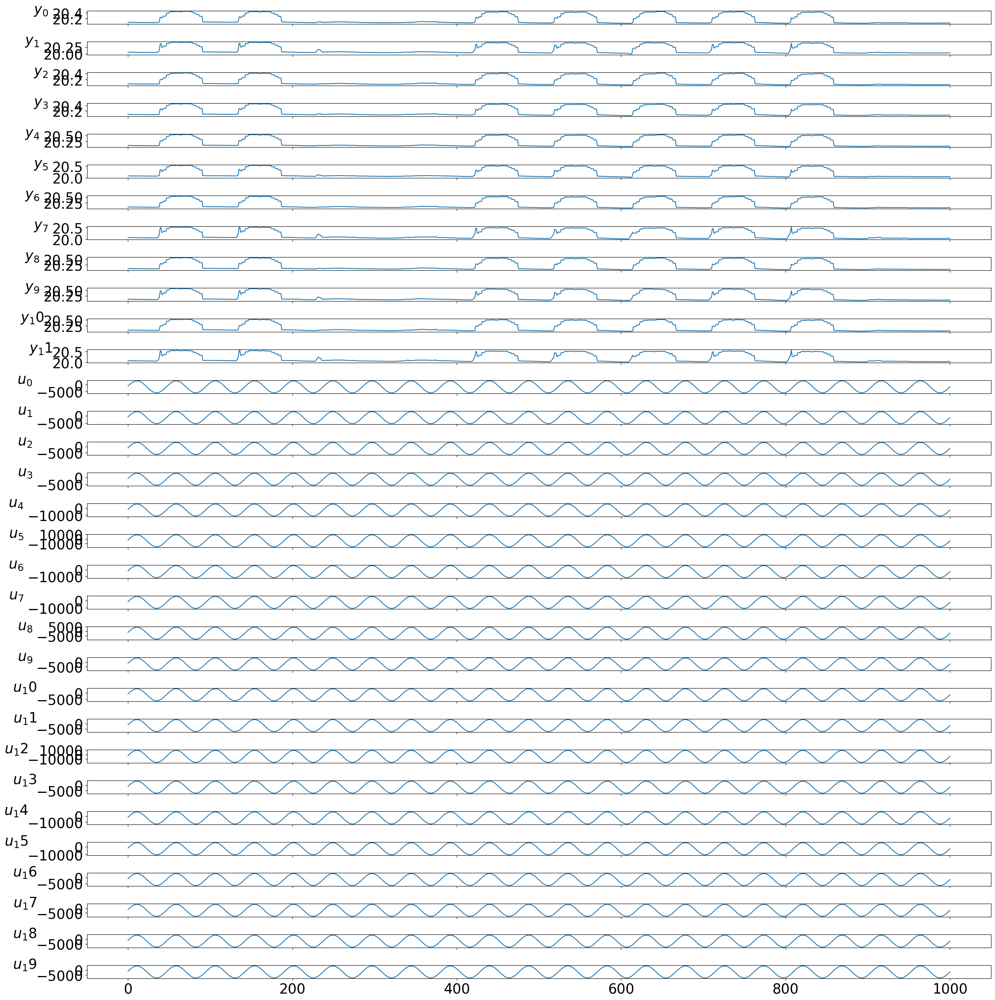

LinearInfrax_full


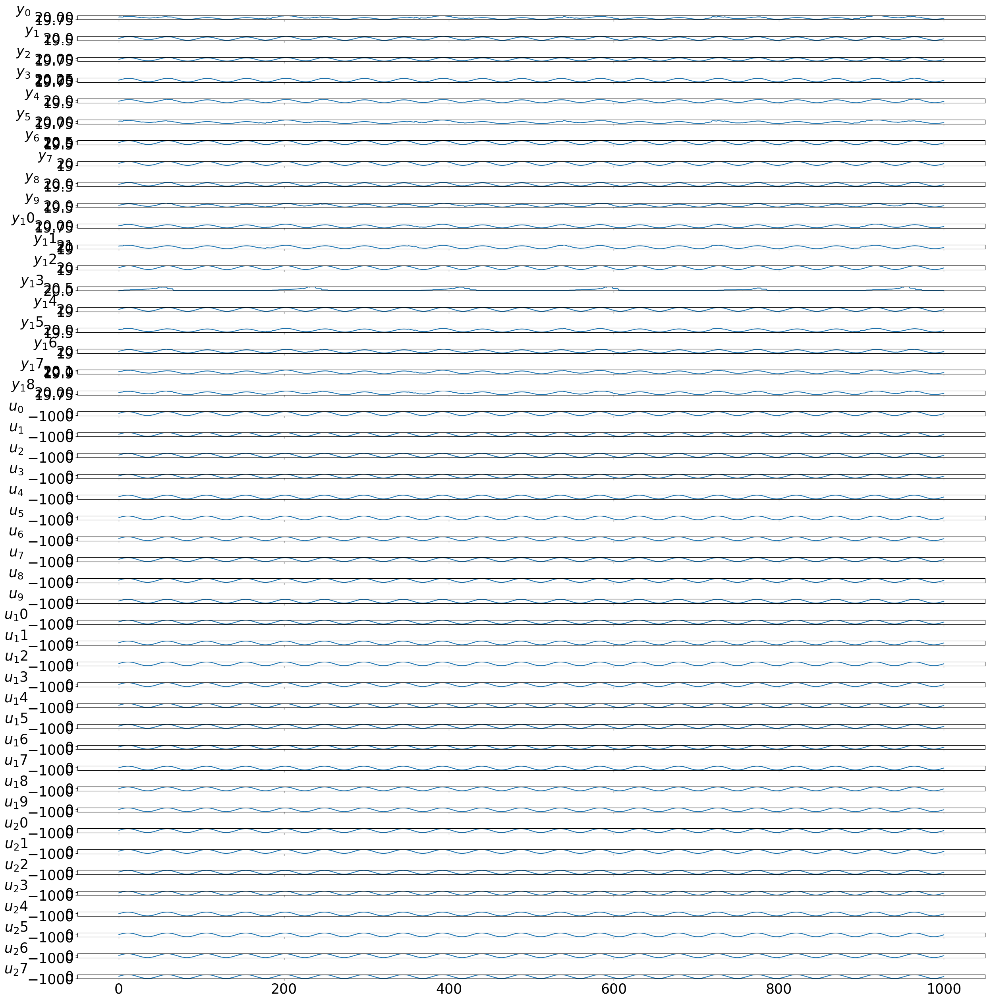

LinearInfrax_ROM100


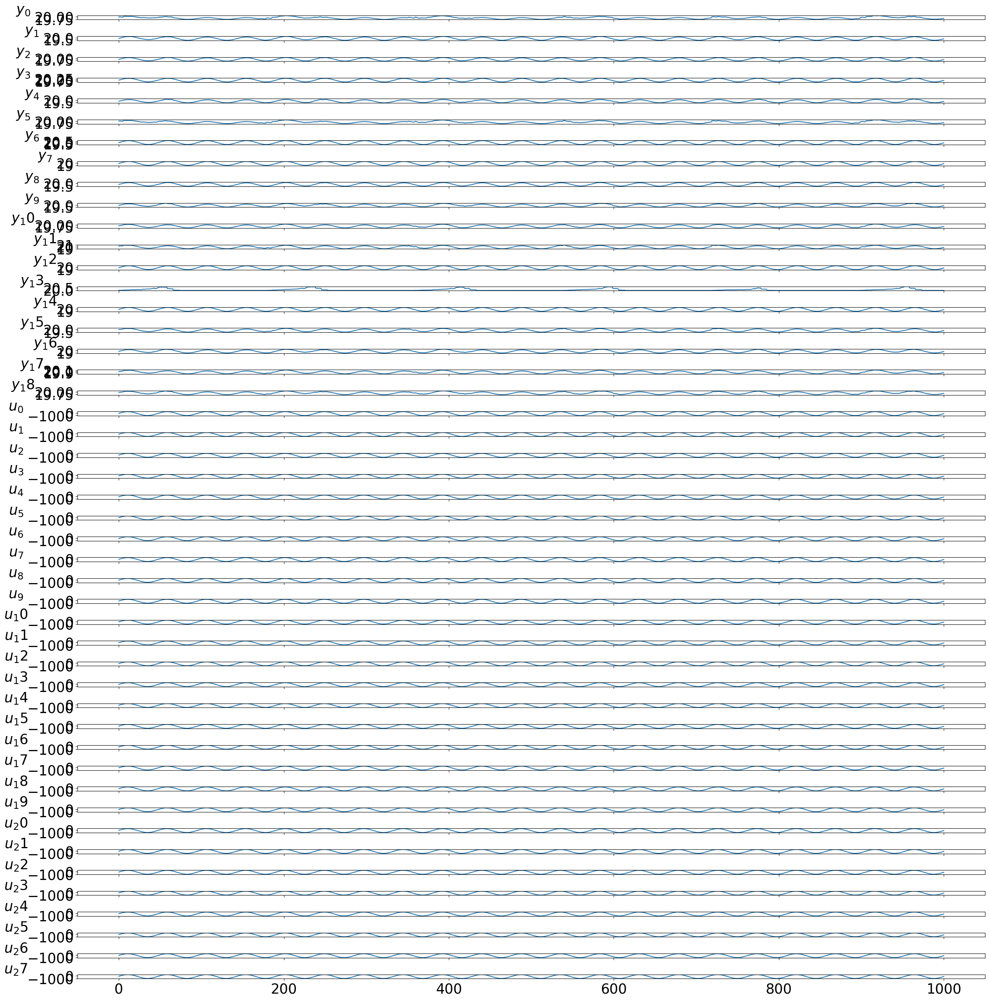

In [251]:
for n, sys in pkg.systems.items():
    print(n)
    sys().show()
    plt.close()

In [253]:
sys = pkg.systems['CSTR']()
print(f'Changing inputs and states: {sys.variables}')
print(f'Constants defining simulation: {sys.constants}')
print(f'Parameters of the system: {sys._params}')
print(f'number of inputs: {sys.nu}')
print(f'state dimension: {sys.nx}')
import pprint
pprint.pprint(sys.stats)

Changing inputs and states: {'x0': [0.87725294608097, 324.475443431599], 'U': array([[302.544],
       [302.544],
       [302.544],
       ...,
       [299.658],
       [297.834],
       [297.834]], dtype=float32)}
Constants defining simulation: {'ts': 0.1, 'Ca_ss': 0.87725294608097, 'T_ss': 324.475443431599}
Parameters of the system: {'q': 100.0, 'V': 100.0, 'rho': 1000.0, 'Cp': 0.239, 'mdelH': 50000.0, 'EoverR': 8750.0, 'k0': 72000000000.0, 'UA': 50000.0, 'u_ss': 300.0, 'Tf': 350.0, 'Caf': 1.0}
number of inputs: 1
state dimension: 2
{'U': {'max': array([302.772], dtype=float32),
       'mean': array([299.82333], dtype=float32),
       'min': array([297.456], dtype=float32),
       'std': array([1.5503372], dtype=float32),
       'var': array([2.4035454], dtype=float32)},
 'X': {'max': array([  0.9055839, 331.11945  ], dtype=float32),
       'mean': array([  0.875514, 324.47693 ], dtype=float32),
       'min': array([  0.8177328, 320.6824   ], dtype=float32),
       'std': array([0.02

# Defining an ODE based dynamical system in PSL

Consider the hamiltonian system on a plane defined by the ordinary differential equations: 
\dot{\theta} = \phi, \dot{\phi} = -\frac{g}{l}\sin\theta

$$x_0^{\prime} = x_1$$
$$x_1^{\prime} = \frac{g}{l} \sin(x_0)$$

Let's define using PSL with $$g = -1, l = 1$$ to simulate an undamped pendulum with no driving force.

In [257]:
from pkg.base import ODE_Autonomous, cast_backend
import numpy as np

class Hamiltonian(ODE_Autonomous):

    @property
    def params(self):
        variables = {'x0': [-2., 2.]} # Initial condition
        constants = {'ts': 0.1} # Time step for numerical simulation
        parameters = {'g': -1., # parameters of the hamiltonian system
                      'l': 1.}
        meta = {}
        return variables, constants, parameters, meta
        
    @cast_backend
    def equations(self, t, x):
        return [x[1], (self.g/self.l)*np.sin(x[0])]
    

Changing inputs and states: {'x0': [-2.0, 2.0]}
Constants defining simulation: {'ts': 0.1}
Parameters of the system: {'g': -1.0, 'l': 1.0}
state dimension: 2
{'X': {'max': array([210.65945  ,   2.6138651], dtype=float32),
       'mean': array([104.56443  ,   2.1243093], dtype=float32),
       'min': array([-1.7953291,  1.6829408], dtype=float32),
       'std': array([61.34368   ,  0.32879055], dtype=float32),
       'var': array([3.7630474e+03, 1.0810323e-01], dtype=float32)},
 'Y': {'max': array([210.65945  ,   2.6138651], dtype=float32),
       'mean': array([104.56443  ,   2.1243093], dtype=float32),
       'min': array([-1.7953291,  1.6829408], dtype=float32),
       'std': array([61.34368   ,  0.32879055], dtype=float32),
       'var': array([3.7630474e+03, 1.0810323e-01], dtype=float32)}}


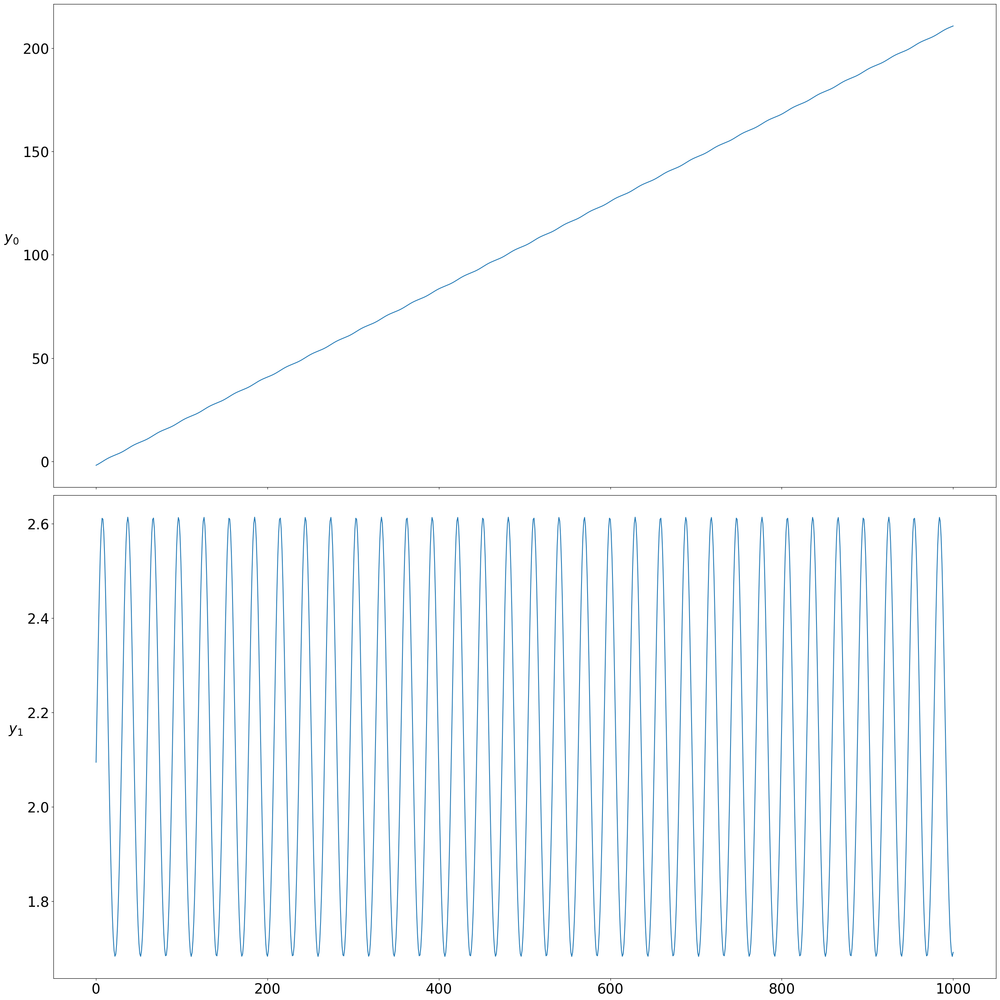

In [262]:
sys = Hamiltonian()
print(f'Changing inputs and states: {sys.variables}')
print(f'Constants defining simulation: {sys.constants}')
print(f'Parameters of the system: {sys._params}')
print(f'state dimension: {sys.nx}')
import pprint
pprint.pprint(sys.stats)
sys.show()
plt.close()

In [263]:
def plot_field(sys, xlim, ylim, scale=100, density=15j):
    X, Y = np.mgrid[xlim[0]:xlim[1]:density, ylim[0]:ylim[1]:density]
    print(X.shape, Y.shape)
    u, v = sys.equations(None, [X, Y])
    print(u.shape, v.shape)
    plt.quiver(X, Y, u, v, color='b', scale=scale)


(15, 15) (15, 15)
(15, 15) (15, 15)


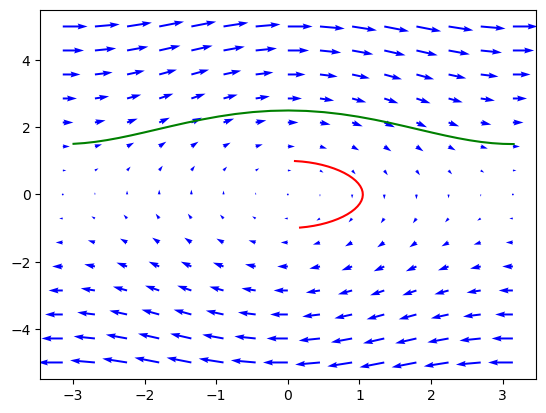

In [264]:
plot_field(Hamiltonian(), (-np.pi, np.pi), (-5, 5))
sys.ts = 0.1
data1 = sys.simulate(nsim=32, x0=np.array([0, 1]))
data2 = sys.simulate(nsim=32, x0=np.array([-np.pi, 1.5]))
plt.plot(data1['X'][:, 0], data1['X'][:, 1], c='r')
plt.plot(data2['X'][:, 0], data2['X'][:, 1], c='g')
# plt.xlim((-2*np.pi, 2*np.pi))

# Modeling a dynamical system from data with NODEs

Let's say we have measurements of this system from a sample of initial conditions simulated for 400 time-steps. How many uniformly sampled initial conditions does it take to learn a decent model of this system? 

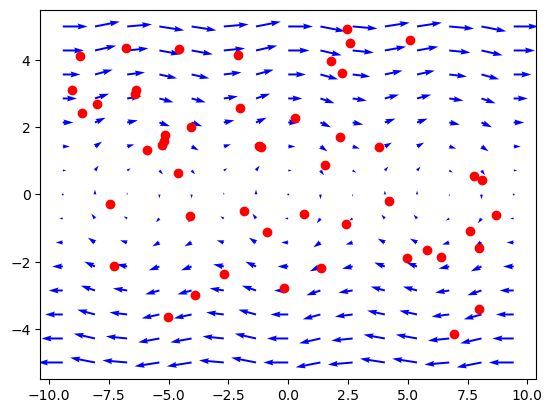

In [48]:
from pkg.system import EulerIntegrator, Node, System
import torch
# Sample 50 initial conditions covering the range of system behavior. 
x0s = np.random.uniform(low=np.array([-3*np.pi, -5.]), high=np.array([3*np.pi, 5]), size=(50, 2))
plot_field(sys, (-3*np.pi, 3*np.pi), (-5, 5))
plt.scatter(x0s[:, 0], x0s[:, 1], c='r')


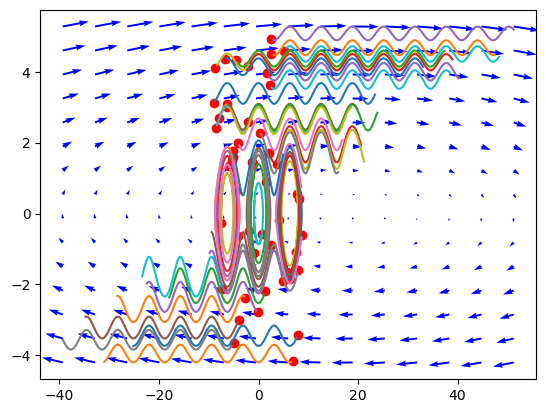

In [51]:
samples = [sys.simulate(nsim=96, x0=x0) for x0 in x0s]
X = np.concatenate([s['X'] for s in samples])
maxx, minx = X[:, 0].max(), X[:, 0].min()
maxy, miny = X[:, 1].max(), X[:, 1].min()

plot_field(sys, (minx, maxx), (miny, maxy))
for s in samples:
    plt.plot(s['X'][:, 0], s['X'][:, 1])
plt.scatter(x0s[:, 0], x0s[:, 1], c='r')


In [25]:
# Change the default system stats to statistics from our training set
pprint.pprint(sys.stats)
sys.set_stats(sim={'X': X})
pprint.pprint(sys.stats)

# Create a pytorch dataloader for use in training the system model
samples = {'X': torch.stack([torch.tensor(s['X'], dtype=torch.float32) for s in samples])}
samples = sys.normalize(samples)
samples['X'].shape, type(samples['X'])


{'X': {'max': array([142.39224 ,  14.815533], dtype=float32),
       'mean': array([11.152533,  2.32702 ], dtype=float32),
       'min': array([-117.9669  ,  -12.608469], dtype=float32),
       'std': array([41.3301  ,  7.402246], dtype=float32),
       'var': array([1708.1771  ,   54.793243], dtype=float32)}}
{'X': {'max': array([48.397705 ,  4.9502306], dtype=float32),
       'mean': array([0.90782225, 0.07822285], dtype=float32),
       'min': array([-47.78219 ,  -4.895431], dtype=float32),
       'std': array([16.116982 ,  2.8585703], dtype=float32),
       'var': array([259.75708 ,   8.171425], dtype=float32)}}


(torch.Size([50, 96, 2]), torch.Tensor)

In [179]:
from neuromancer.dataset import DictDataset

# Make a function to generate data
def get_data(sys, xmin, xmax, nstep, nsamples, name='train'):
    
    # Sample initial conditions
    x0s = np.random.uniform(low=xmin, high=xmax, size=(nsamples, sys.nx))
    
    # Create nsamples simulations with sampled initial conditions
    samples = [sys.simulate(nsim=nstep, x0=x0) for x0 in x0s]
    
    # Calculate min and max for plotting axis bounds    
    X = np.concatenate([s['X'] for s in samples])
    maxx, minx = X[:, 0].max(), X[:, 0].min()
    maxy, miny = X[:, 1].max(), X[:, 1].min()

    # Plot vector field, initial conditions and samples
    plot_field(sys, (minx, maxx), (miny, maxy))
    for s in samples:
        plt.plot(s['X'][:, 0], s['X'][:, 1])
    plt.scatter(x0s[:, 0], x0s[:, 1], c='r')
    
    if name == 'train':
        # Change the default system stats to statistics from our training set
        pprint.pprint(sys.stats)
        sys.set_stats(sim={'X': X})
        pprint.pprint(sys.stats)

    # Create a pytorch dataloader
    samples = {'X': torch.stack([torch.tensor(s['X'], dtype=torch.float32) for s in samples])}
    samples = sys.normalize(samples)
    
    data = DictDataset(samples, name=name)
    loader = torch.utils.data.DataLoader(data, num_workers=1, batch_size=50, collate_fn=data.collate_fn,
                                         shuffle=True)
    return loader

(15, 15) (15, 15)
(15, 15) (15, 15)
{'X': {'max': array([57.132427 ,  5.3023267], dtype=float32),
       'mean': array([0.3129481 , 0.05953242], dtype=float32),
       'min': array([-53.954865 ,  -5.1293287], dtype=float32),
       'std': array([17.618279 ,  3.0016053], dtype=float32),
       'var': array([310.40375 ,   9.009634], dtype=float32)}}
{'X': {'max': array([51.286907,  5.214612], dtype=float32),
       'mean': array([0.24969937, 0.23515075], dtype=float32),
       'min': array([-55.707687 ,  -5.1470847], dtype=float32),
       'std': array([16.077755 ,  2.8101127], dtype=float32),
       'var': array([258.4942  ,   7.896733], dtype=float32)}}


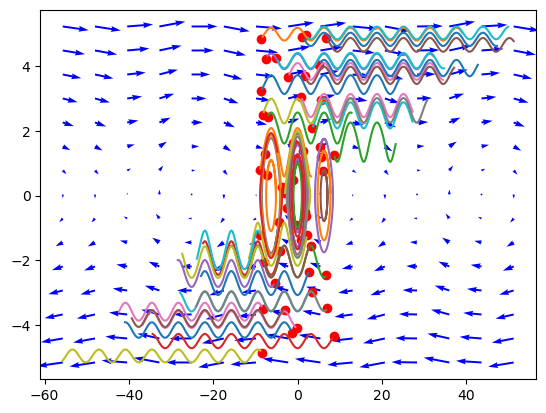

In [180]:
train_data = get_data(sys, np.array([-3*np.pi, -5.]), np.array([3*np.pi, 5]), 96, 50, name='train')

(15, 15) (15, 15)
(15, 15) (15, 15)


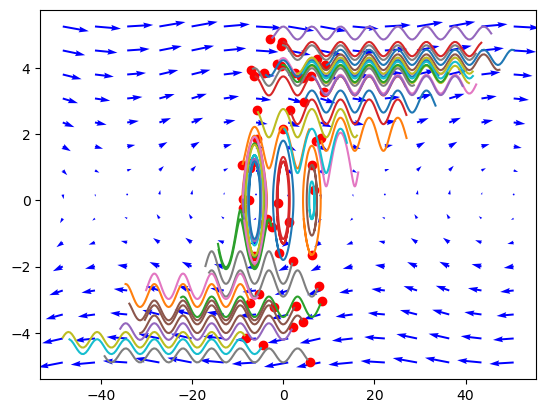

In [181]:
dev_data = get_data(sys, np.array([-3*np.pi, -5.]), np.array([3*np.pi, 5]), 96, 50, name='dev')

In [241]:
from pkg.system import Node, System, EulerIntegrator
from neuromancer.blocks import MLP
from neuromancer.integrators import Euler
from neuromancer.activations import SoftExponential

class MultipleShootingEulerIntegrator(torch.nn.Module):
    """
    Simple black-box NODE
    """
    def __init__(self, nx, hsize, nlayers, ts):
        super().__init__()
        self.dx = MLP(nx, nx, hsizes=[hsize for h in range(nlayers)], nonlin=SoftExponential)
        self.integrator = Euler(self.dx, h=torch.tensor(ts))

    def forward(self, x1, xn):
        """

        :param xn: (Tensor, shape=(batchsize, nx)) State
        :param u: (Tensor, shape=(batchsize, nu)) Control action
        :return: (Tensor, shape=(batchsize, nx)) xn+1
        """
        return self.integrator(x1), self.integrator(xn)

nx = 2
hsize = 64
nlayers = 3
integrator = MultipleShootingEulerIntegrator(nx, hsize, nlayers, sys.ts)
node = Node(integrator, ['X', 'xn'], ['xstep', 'xn'])
system = System([node])

In [242]:
from neuromancer.trainer import Trainer
from neuromancer.loggers import BasicLogger
from neuromancer.constraint import variable
from neuromancer.loss import PenaltyLoss
from neuromancer.problem import Problem

logger = BasicLogger(stdout=['train_objective_loss', 'dev_loss2'], verbosity=1)
opt = torch.optim.AdamW(integrator.parameters(), 0.001)
xpred = variable('xn')[:, :-1, :]
xtrue = variable('X')
x1pred = variable('xstep')

loss1 = (xpred == xtrue) ^ 2
loss1.update_name('loss1')
loss2 = (x1pred[:, :-1, :] == xtrue[:, 1:, :])^2
loss2.update_name('loss2')

obj = PenaltyLoss([loss1, loss2], [])
problem = Problem([system], obj)

trainer = Trainer(problem, train_data, dev_data, dev_data, opt, logger,
                  epochs=1000,
                  patience=1000,
                  train_metric='train_objective_loss',
                  dev_metric='dev_loss',
                  test_metric='test_loss',
                  eval_metric='dev_loss')


None
Number of parameters: 8645


In [243]:
best_model = trainer.train()

epoch: 0	train_objective_loss: 2.11205	dev_loss2: 0.00045	eltime:  3.21354
epoch: 1	train_objective_loss: 0.56536	dev_loss2: 0.00035	eltime:  3.84920
epoch: 2	train_objective_loss: 0.15052	dev_loss2: 0.00036	eltime:  4.47540
epoch: 3	train_objective_loss: 0.13337	dev_loss2: 0.00041	eltime:  5.08441
epoch: 4	train_objective_loss: 0.21410	dev_loss2: 0.00046	eltime:  5.71700
epoch: 5	train_objective_loss: 0.26033	dev_loss2: 0.00050	eltime:  6.32671
epoch: 6	train_objective_loss: 0.28278	dev_loss2: 0.00052	eltime:  6.94272
epoch: 7	train_objective_loss: 0.28156	dev_loss2: 0.00051	eltime:  7.60612
epoch: 8	train_objective_loss: 0.25355	dev_loss2: 0.00049	eltime:  8.24935
epoch: 9	train_objective_loss: 0.21115	dev_loss2: 0.00046	eltime:  8.89762
epoch: 10	train_objective_loss: 0.17131	dev_loss2: 0.00044	eltime:  9.51165
epoch: 11	train_objective_loss: 0.14452	dev_loss2: 0.00042	eltime:  10.10256
epoch: 12	train_objective_loss: 0.12876	dev_loss2: 0.00041	eltime:  10.72499
epoch: 13	train_obje

epoch: 107	train_objective_loss: 0.07076	dev_loss2: 0.00032	eltime:  71.00364
epoch: 108	train_objective_loss: 0.07069	dev_loss2: 0.00032	eltime:  71.66454
epoch: 109	train_objective_loss: 0.07064	dev_loss2: 0.00032	eltime:  72.24890
epoch: 110	train_objective_loss: 0.07059	dev_loss2: 0.00032	eltime:  72.86437
epoch: 111	train_objective_loss: 0.07056	dev_loss2: 0.00032	eltime:  73.53483
epoch: 112	train_objective_loss: 0.07054	dev_loss2: 0.00032	eltime:  74.18367
epoch: 113	train_objective_loss: 0.07053	dev_loss2: 0.00032	eltime:  74.86177
epoch: 114	train_objective_loss: 0.07053	dev_loss2: 0.00032	eltime:  75.51425
epoch: 115	train_objective_loss: 0.07053	dev_loss2: 0.00032	eltime:  76.17920
epoch: 116	train_objective_loss: 0.07053	dev_loss2: 0.00032	eltime:  76.81266
epoch: 117	train_objective_loss: 0.07054	dev_loss2: 0.00032	eltime:  77.49266
epoch: 118	train_objective_loss: 0.07055	dev_loss2: 0.00032	eltime:  78.74249
epoch: 119	train_objective_loss: 0.07056	dev_loss2: 0.00032	elti

epoch: 212	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  141.19412
epoch: 213	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  141.83275
epoch: 214	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  142.46347
epoch: 215	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  143.10253
epoch: 216	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  143.73042
epoch: 217	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  144.36630
epoch: 218	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  145.04739
epoch: 219	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  145.67954
epoch: 220	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  146.35011
epoch: 221	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  147.00011
epoch: 222	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  147.64513
epoch: 223	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  148.30394
epoch: 224	train_objective_loss: 0.07052	dev_loss2: 

epoch: 316	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  212.66966
epoch: 317	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  213.33423
epoch: 318	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  213.96930
epoch: 319	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  214.60376
epoch: 320	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  215.23973
epoch: 321	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  215.87137
epoch: 322	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  216.53167
epoch: 323	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  217.18442
epoch: 324	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  217.83789
epoch: 325	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  218.49981
epoch: 326	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  219.15842
epoch: 327	train_objective_loss: 0.07052	dev_loss2: 0.00032	eltime:  219.80875
epoch: 328	train_objective_loss: 0.07052	dev_loss2: 

Exception ignored in: <function _after_fork at 0x7fd8ff6670a0>
Traceback (most recent call last):
  File "/home/tuor369/anaconda3/envs/neuromancer/lib/python3.10/threading.py", line 1584, in _after_fork
    def _after_fork():
KeyboardInterrupt: 


Interrupted training loop.


In [219]:
trainer.model.load_state_dict(best_model)
opt.param_groups[0]['lr'] = 0.01
best_model = trainer.train()


epoch: 99	train_objective_loss: 0.16216	dev_loss2: 0.00033	eltime:  50.65707
epoch: 100	train_objective_loss: 0.16211	dev_loss2: 0.00030	eltime:  51.06805
epoch: 101	train_objective_loss: 0.16202	dev_loss2: 0.00026	eltime:  51.46111
epoch: 102	train_objective_loss: 0.16192	dev_loss2: 0.00022	eltime:  51.85631
epoch: 103	train_objective_loss: 0.16182	dev_loss2: 0.00018	eltime:  52.25556
epoch: 104	train_objective_loss: 0.16173	dev_loss2: 0.00015	eltime:  52.66185
epoch: 105	train_objective_loss: 0.16166	dev_loss2: 0.00012	eltime:  53.07460
epoch: 106	train_objective_loss: 0.16161	dev_loss2: 0.00010	eltime:  53.48915
epoch: 107	train_objective_loss: 0.16157	dev_loss2: 0.00009	eltime:  53.92645
epoch: 108	train_objective_loss: 0.16153	dev_loss2: 0.00009	eltime:  54.34368
epoch: 109	train_objective_loss: 0.16149	dev_loss2: 0.00009	eltime:  54.77779
epoch: 110	train_objective_loss: 0.16144	dev_loss2: 0.00009	eltime:  55.21569
epoch: 111	train_objective_loss: 0.16138	dev_loss2: 0.00009	eltim

(15, 15) (15, 15)
torch.Size([225, 2])
(15, 15) (15, 15)


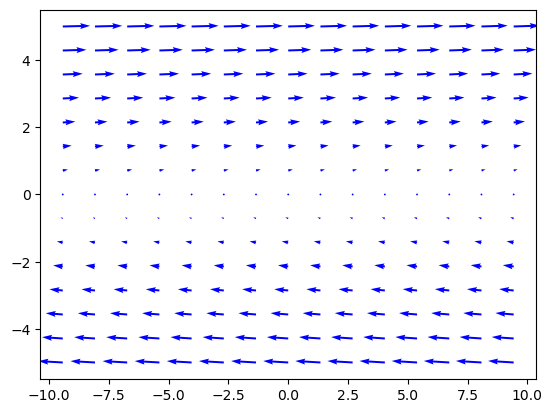

In [244]:
class rhs_wrapper:
    
    def __init__(self, dx, sys):
        self.dx = dx
        self.sys = sys
        
    def equations(self, t, X):
        X = torch.tensor(np.stack(X, axis=-1), dtype=torch.float32).reshape(-1, 2)
        print(X.shape)
        X = self.sys.normalize(X, key='X')
        output = self.dx(X)
        output = self.sys.denormalize(output, key='X')
        output = output.reshape(15, 15, 2).detach().numpy()
        return output[:, :, 0], output[:, :, 1]

problem.load_state_dict(best_model)
        
rhs = integrator.dx
func = rhs_wrapper(rhs, sys)
plot_field(func, (-3*np.pi, 3*np.pi), (-5, 5))

(15, 15) (15, 15)
(15, 15) (15, 15)


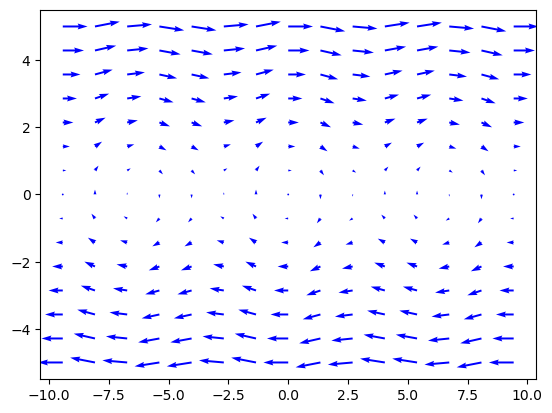

In [245]:
plot_field(sys, (-3*np.pi, 3*np.pi), (-5, 5))

# Non-autonomous system ID for control

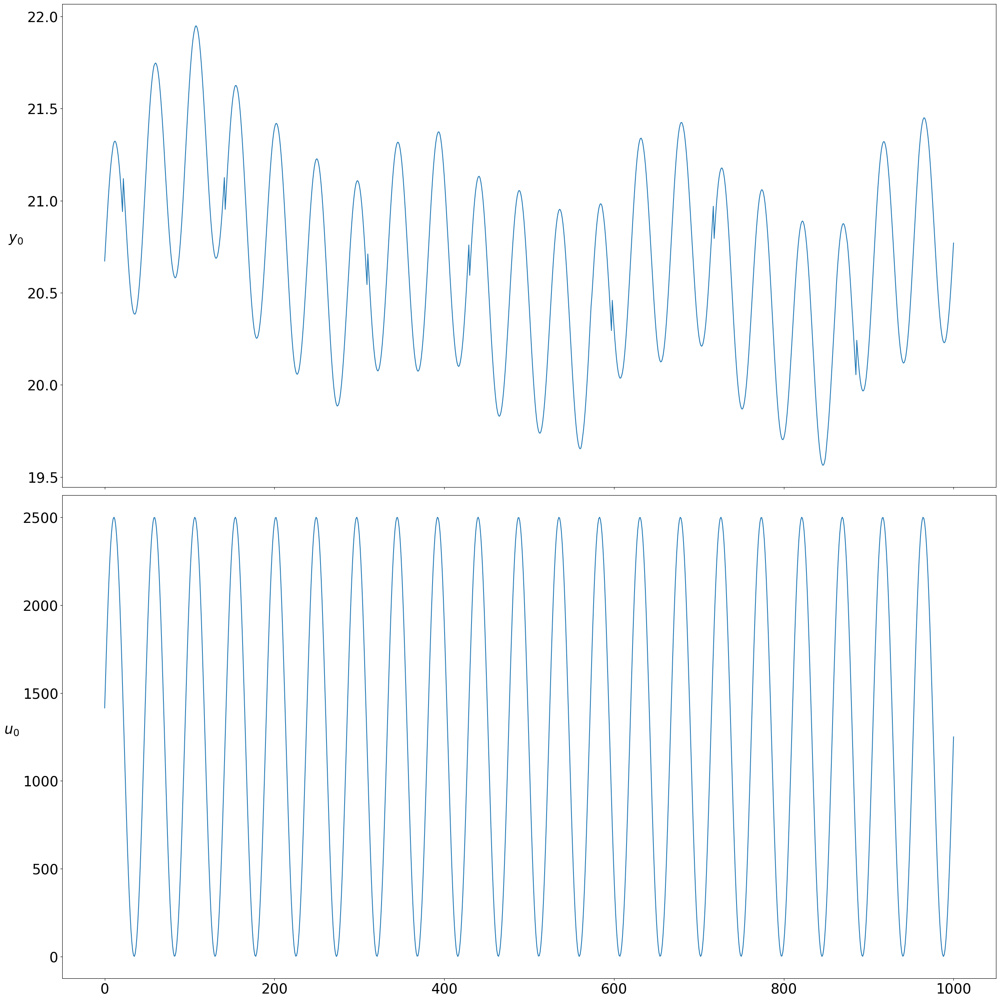

In [247]:
sys = pkg.systems['LinearSimpleSingleZone']()
sys.show()

In [249]:
# Non-autonomous NODE
class EulerIntegrator(torch.nn.Module):
    """
    Simple black-box NODE
    """
    def __init__(self, ny, nu, nd, hsize, nlayers, ts):
        super().__init__()
        self.dy = MLP(ny + nu + nd, ny, bias=True, linear_map=nn.Linear, nonlin=SoftExponential,
                      hsizes=[hsize for h in range(nlayers)])
        interp_u = lambda tq, t, u: u
        self.integrator = Euler(self.dy, h=0.001, interp_u=interp_u)
        self.bias = nn.Parameter(torch.randn(ny), requires_grad=True)

    def forward(self, yn, ystep, u, d):
        """

        :param xn: (Tensor, shape=(batchsize, nx)) State
        :param u: (Tensor, shape=(batchsize, nu)) Control action
        :return: (Tensor, shape=(batchsize, nx)) xn+1
        """
        return self.integrator(yn, u=torch.cat([u, d], dim=-1)), self.integrator(ystep, u=torch.cat([u, d], dim=-1)) + self.bias

# Closed loop system for Control

Notes: 
+ Lotka Volterra might be an easier system.
+ Overfit on a single initial condition and look at learned vector field
    + subtract learned vector field from ground truth and make a contour map
    
    